In [1]:
import numpy as np
from pydub import AudioSegment
import random
import sys
import io
import os
import glob
import IPython
from td_utils import *
%matplotlib inline

In [2]:
Tx = 5511 # The number of time steps input to the model from the spectrogram
n_freq = 101 # Number of frequencies input to the model at each time step of the spectrogram
Ty = 1375 # The number of time steps in the output of our model

In [3]:
activates, negatives, backgrounds = load_raw_audio_thalon_list()
print(len(activates), len(negatives), len(backgrounds))
# 190 7058 8642

30 7058 168


In [4]:
# print(activates)
print(activates[0])
print(negatives[0])
print(backgrounds[0])

./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
./database/wav_resampling/general_lt_1sec/common_voice_es_18816198.wav
./database/my_database/background_10sec/output_22_1.wav


In [5]:
def get_random_time_segment(segment_ms):
    """
    Gets a random time segment of duration segment_ms in a 10,000 ms audio clip.
    
    Arguments:
    segment_ms -- the duration of the audio clip in ms ("ms" stands for "milliseconds")
    
    Returns:
    segment_time -- a tuple of (segment_start, segment_end) in ms
    """
    
    segment_start = np.random.randint(low=0, high=10000-segment_ms)   # Make sure segment doesn't run past the 10sec background 
    segment_end = segment_start + segment_ms - 1
    
    return (segment_start, segment_end)

In [6]:
# GRADED FUNCTION: is_overlapping

def is_overlapping(segment_time, previous_segments):
    """
    Checks if the time of a segment overlaps with the times of existing segments.
    
    Arguments:
    segment_time -- a tuple of (segment_start, segment_end) for the new segment
    previous_segments -- a list of tuples of (segment_start, segment_end) for the existing segments
    
    Returns:
    True if the time segment overlaps with any of the existing segments, False otherwise
    """
    
    segment_start, segment_end = segment_time
    
    ### START CODE HERE ### (≈ 4 line)
    # Step 1: Initialize overlap as a "False" flag. (≈ 1 line)
    overlap = False
    
    # Step 2: loop over the previous_segments start and end times.
    # Compare start/end times and set the flag to True if there is an overlap (≈ 3 lines)
    for previous_start, previous_end in previous_segments:
        if segment_start <= previous_end and segment_end >= previous_start:
            overlap = True
    ### END CODE HERE ###

    return overlap

In [7]:
# GRADED FUNCTION: insert_audio_clip

def insert_audio_clip(background, audio_clip, previous_segments):
    """
    Insert a new audio segment over the background noise at a random time step, ensuring that the 
    audio segment does not overlap with existing segments.
    
    Arguments:
    background -- a 10 second background audio recording.  
    audio_clip -- the audio clip to be inserted/overlaid. 
    previous_segments -- times where audio segments have already been placed
    
    Returns:
    new_background -- the updated background audio
    """
    
    # Get the duration of the audio clip in ms
    segment_ms = len(audio_clip)
    
    # print('previous_segments #1:', previous_segments)
    
    ### START CODE HERE ### 
    # Step 1: Use one of the helper functions to pick a random time segment onto which to insert 
    # the new audio clip. (≈ 1 line)
    segment_time = get_random_time_segment(segment_ms)
    
    # Step 2: Check if the new segment_time overlaps with one of the previous_segments. If so, keep 
    # picking new segment_time at random until it doesn't overlap. (≈ 2 lines)
    while is_overlapping(segment_time, previous_segments):
        segment_time = get_random_time_segment(segment_ms)
        # print('overlapping, try again')

    # Step 3: Add the new segment_time to the list of previous_segments (≈ 1 line)
    previous_segments.append(segment_time)
    ### END CODE HERE ###
    
    # Step 4: Superpose audio segment and background
    new_background = background.overlay(audio_clip, position = segment_time[0])
    
    return new_background, segment_time

In [8]:
# GRADED FUNCTION: insert_ones

def insert_ones(y, segment_end_ms):
    """
    Update the label vector y. The labels of the 50 output steps strictly after the end of the segment 
    should be set to 1. By strictly we mean that the label of segment_end_y should be 0 while, the
    50 followinf labels should be ones.
    
    
    Arguments:
    y -- numpy array of shape (1, Ty), the labels of the training example
    segment_end_ms -- the end time of the segment in ms
    
    Returns:
    y -- updated labels
    """
    
    # duration of the background (in terms of spectrogram time-steps)
    segment_end_y = int(segment_end_ms * Ty / 10000.0)
    
    # Add 1 to the correct index in the background label (y)
    ### START CODE HERE ### (≈ 3 lines)
    for i in range(segment_end_y + 1, segment_end_y + 51):
        if i < Ty:
            y[0, i] = 1
    ### END CODE HERE ###
    
    return y

In [9]:
# GRADED FUNCTION: create_training_example

def create_training_example(counter, backgrounds, activates, negatives):
    """
    Creates a training example with a given background, activates, and negatives.
    
    Arguments:
    background -- a 10 second background audio recording
    activates -- a list of audio segments of the word "activate"
    negatives -- a list of audio segments of random words that are not "activate"
    
    Returns:
    x -- the spectrogram of the training example
    y -- the label at each time step of the spectrogram
    """
    
    # Select 0-4 random "activate" audio clips from the entire list of "activates" recordings
    random_activates = load_raw_data(random.sample(activates, k=random.randint(1, 3)))
    print('random_activates', len(random_activates))
    
    # Select 0-2 random negatives audio recordings from the entire list of "negatives" recordings
    random_negatives = load_raw_data(random.sample(negatives, k=random.randint(1, 3)))
    print('random_negatives', len(random_negatives))
    
    background = load_raw_data(random.sample(backgrounds, k=1))
    print('background', len(background))
    
    # Make background quieter
    background = background[0] - 20

    ### START CODE HERE ###
    # Step 1: Initialize y (label vector) of zeros (≈ 1 line)
    y = np.zeros((1, Ty))

    # Step 2: Initialize segment times as empty list (≈ 1 line)
    previous_segments = []
    ### END CODE HERE ###
    
    
    ### START CODE HERE ### (≈ 3 lines)
    # Step 3: Loop over randomly selected "activate" clips and insert in background
    for random_activate in random_activates:
        # Insert the audio clip on the background
        background, segment_time = insert_audio_clip(background, random_activate, previous_segments)
        # Retrieve segment_start and segment_end from segment_time
        segment_start, segment_end = segment_time
        # Insert labels in "y"
        y = insert_ones(y, segment_end_ms=segment_end)
    ### END CODE HERE ###
    
    print('previous_segments_active:', previous_segments)    

    ### START CODE HERE ### (≈ 2 lines)
    # Step 4: Loop over randomly selected negative clips and insert in background
    for random_negative in random_negatives:
        # Insert the audio clip on the background 
        background, _ = insert_audio_clip(background, random_negative - 10.0, previous_segments)
    ### END CODE HERE ###
    
    # Standardize the volume of the audio clip 
    background = match_target_amplitude(background, -20.0)
    
    print('previous_segments_total:', previous_segments)

    # Export new training example 
    file_handle = background.export("./raw_thalon_audios_stereo/train_" + str(counter) + ".wav", format="wav")
    print("File (train_" + str(counter) + ".wav) was saved in your directory.")
    
    # Get and plot spectrogram of the new recording (background with superposition of positive and negatives)
    x = graph_spectrogram("./raw_thalon_audios_stereo/train_" + str(counter) + ".wav")
    
    return x, y

Creating 1 of 2000. Progress: 0.0005
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730339.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_6_1.wav
background 1
previous_segments_active: [(847, 1708), (5492, 6443)]
previous_segments_total: [(847, 1708), (5492, 6443), (3325, 4324)]
File (train_1.wav) was saved in your directory.
Creating 2 of 2000. Progress: 0.001
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18528785.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18507958.wav
random_negatives 2
opening ./database/

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18473053.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751497.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_30_2.wav
background 1
previous_segments_active: [(8348, 9050)]
previous_segments_total: [(8348, 9050), (2308, 3307), (6668, 7667), (4541, 5540)]
File (train_15.wav) was saved in your directory.
Creating 16 of 2000. Progress: 0.008
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_29.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18608073.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540401.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_29_2.wav
background 1
previous_segments_active: [(4211, 4918), (2387, 3350),

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18664506.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18758181.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_12_0.wav
background 1
previous_segments_active: [(949, 2014), (7435, 8398)]
previous_segments_total: [(949, 2014), (7435, 8398), (5903, 6902), (4348, 5347), (2254, 3253)]
File (train_28.wav) was saved in your directory.
Creating 29 of 2000. Progress: 0.0145
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18317324.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_5_3.wav
background 1
previous_segments_active: [(778, 1514)]
previous_segments_total: [(778, 1514), (8656, 9655)]
File (train_29.wav) was saved in your directory.
Creating 30 of 2000. Progress: 0.015
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312069.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_9_3.wav
background 1
previous_segments_active: [(8324, 9275), (7204, 7838), (5644, 6550)]
previous_segments_total: [(8324, 9275), (7204, 7838), (5644, 6550), (3846, 4845), (1856, 2855), (637, 1636)]
File (train_43.wav) was saved in your directory.
Creating 44 of 2000. Progress: 0.022
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_26.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_29.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18688207.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_40_2.wav
background 1
previous_segments_active: [(6347, 6981), (1405, 2112), (4283, 4895)]
previous_segments_total: [(6347, 6981), (1405, 2112), (4283, 4895), (3172, 4171)]
File (tr

Creating 58 of 2000. Progress: 0.029
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365421.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_41_1.wav
background 1
previous_segments_active: [(1588, 2324)]
previous_segments_total: [(1588, 2324), (4032, 5031)]
File (train_58.wav) was saved in your directory.
Creating 59 of 2000. Progress: 0.0295
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18686288.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18694529.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726159.wav
random_negatives 3
opening ./database/my_database/ba

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502695.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_19_2.wav
background 1
previous_segments_active: [(197, 1103), (5575, 6391), (1303, 2311)]
previous_segments_total: [(197, 1103), (5575, 6391), (1303, 2311), (8131, 9130), (6576, 7575)]
File (train_72.wav) was saved in your directory.
Creating 73 of 2000. Progress: 0.0365
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18538439.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18856736.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687158.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_2_1.wav
background 1
previous_segmen

Creating 88 of 2000. Progress: 0.044
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18641450.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_18_2.wav
background 1
previous_segments_active: [(1586, 2220), (8821, 9546)]
previous_segments_total: [(1586, 2220), (8821, 9546), (5060, 6059)]
File (train_88.wav) was saved in your directory.
Creating 89 of 2000. Progress: 0.0445
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18835977.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726153.wav
opening ./database/wav_resamplin

Creating 102 of 2000. Progress: 0.051
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465518.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359451.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_38_3.wav
background 1
previous_segments_active: [(8035, 9100), (455, 1452)]
previous_segments_total: [(8035, 9100), (455, 1452), (5205, 6204), (2857, 3856)]
File (train_102.wav) was saved in your directory.
Creating 103 of 2000. Progress: 0.0515
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18792547.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18528705.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_13_3.

File (train_115.wav) was saved in your directory.
Creating 116 of 2000. Progress: 0.058
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18370908.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18323337.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_16_3.wav
background 1
previous_segments_active: [(6573, 7423), (5570, 6283), (3631, 4424)]
previous_segments_total: [(6573, 7423), (5570, 6283), (3631, 4424), (2260, 3259), (8568, 9567)]
File (train_116.wav) was saved in your directory.
Creating 117 of 2000. Progress: 0.0585
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
random_activates 2
opening ./database

Creating 129 of 2000. Progress: 0.0645
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18438449.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18315326.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_12_0.wav
background 1
previous_segments_active: [(2529, 3492), (8939, 9755), (586, 1311)]
previous_segments_total: [(2529, 3492), (8939, 9755), (586, 1311), (6979, 7978), (5314, 6313)]
File (train_129.wav) was saved in your directory.
Creating 130 of 2000. Progress: 0.065
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 3


random_negatives 3
opening ./database/my_database/background_10sec/output_15_3.wav
background 1
previous_segments_active: [(4636, 5587)]
previous_segments_total: [(4636, 5587), (6251, 7250), (386, 1385), (3470, 4469)]
File (train_142.wav) was saved in your directory.
Creating 143 of 2000. Progress: 0.0715
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18511040.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778753.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676179.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_22_2.wav
background 1
previous_segments_active: [(5306, 6076), (1084, 2149)]
previous_segments_total: [(5306, 6076), (1084, 2149), (3324, 4323), (8501, 9500), (6560, 7559)]
File (train_143.wav) was saved in your directory.
C

Creating 158 of 2000. Progress: 0.079
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311418.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_32_2.wav
background 1
previous_segments_active: [(7350, 8098), (1474, 2176)]
previous_segments_total: [(7350, 8098), (1474, 2176), (3448, 4447)]
File (train_158.wav) was saved in your directory.
Creating 159 of 2000. Progress: 0.0795
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_13.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18762663.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18834107.wav
random_negatives 2
opening ./dat

random_negatives 2
opening ./database/my_database/background_10sec/output_8_1.wav
background 1
previous_segments_active: [(1612, 2405)]
previous_segments_total: [(1612, 2405), (7217, 8216), (3525, 4524)]
File (train_171.wav) was saved in your directory.
Creating 172 of 2000. Progress: 0.086
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_13.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_26.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18784584.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_40_3.wav
background 1
previous_segments_active: [(8435, 9341), (1813, 2447)]
previous_segments_total: [(8435, 9341), (1813, 2447), (6549, 7548)]
File (train_172.wav) was saved in your directory.
Creating 173 of 2000. Progress: 0.0865
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 2
ope

random_negatives 1
opening ./database/my_database/background_10sec/output_37_1.wav
background 1
previous_segments_active: [(5774, 6476), (4826, 5533)]
previous_segments_total: [(5774, 6476), (4826, 5533), (7380, 8379)]
File (train_184.wav) was saved in your directory.
Creating 185 of 2000. Progress: 0.0925
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354623.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_36_0.wav
background 1
previous_segments_active: [(3496, 4266), (6821, 7534), (4424, 5149)]
previous_segments_total: [(3496, 4266), (6821, 7534), (4424, 5149), (5729, 6728)]
File (train_185.wav) was saved in your directory.
Creating 186 of 2000. Progress: 0.093
opening ./thalon_audios/hola_thalon/V2_me_stereo/e

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424181.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_21_1.wav
background 1
previous_segments_active: [(6037, 6785), (3880, 4593)]
previous_segments_total: [(6037, 6785), (3880, 4593), (6828, 7827), (387, 1386), (8743, 9742)]
File (train_200.wav) was saved in your directory.
Creating 201 of 2000. Progress: 0.1005
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354336.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18383828.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_12_0.wav
background 1
previous_segments_active: [(7051, 8002)]
previous_segments_total: [(7051, 8002), (3592, 4591), (478, 1477)]
File (train_201.wav) was saved in your directory.
Creating 202 of 2000. Progress: 0.101
opening ./thalon_audios/hola_thalon/V2_me_stere

Creating 215 of 2000. Progress: 0.1075
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18793893.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18895822.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_13_1.wav
background 1
previous_segments_active: [(6360, 7311), (1231, 1956), (5094, 5944)]
previous_segments_total: [(6360, 7311), (1231, 1956), (5094, 5944), (3660, 4659), (2407, 3406)]
File (train_215.wav) was saved in your directory.
Creating 216 of 2000. Progress: 0.108
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790264.wav
random_negatives 1
opening ./database/my_database/backgroun

File (train_228.wav) was saved in your directory.
Creating 229 of 2000. Progress: 0.1145
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18513911.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_8_1.wav
background 1
previous_segments_active: [(1075, 1925), (6535, 7351)]
previous_segments_total: [(1075, 1925), (6535, 7351), (4350, 5349)]
File (train_229.wav) was saved in your directory.
Creating 230 of 2000. Progress: 0.115
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18664373.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_37_2.wav
background 1
previous_segments_active: [(7938, 8686)]
previous_segments_total: [(7938, 8686), (4545, 5544)]
File (tra

Creating 245 of 2000. Progress: 0.1225
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424163.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311058.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18566192.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_21_2.wav
background 1
previous_segments_active: [(6707, 7432), (8914, 9877)]
previous_segments_total: [(6707, 7432), (8914, 9877), (697, 1696), (3068, 4067), (7852, 8851)]
File (train_245.wav) was saved in your directory.
Creating 246 of 2000. Progress: 0.123
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_13.wav
random_activates 3
ope

random_negatives 2
opening ./database/my_database/background_10sec/output_11_1.wav
background 1
previous_segments_active: [(711, 1503), (1695, 2601)]
previous_segments_total: [(711, 1503), (1695, 2601), (4452, 5451), (6258, 7257)]
File (train_259.wav) was saved in your directory.
Creating 260 of 2000. Progress: 0.13
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321249.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_22_2.wav
background 1
previous_segments_active: [(7945, 8670), (2922, 3885), (6304, 7097)]
previous_segments_total: [(7945, 8670), (2922, 3885), (6304, 7097), (676, 1675)]
File (train_260.wav) was saved in your directory.
Creating 261 of 2000. Progress: 0.1305
opening ./thalon_audios/hola_thalon/V2_m

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830496.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_1_1.wav
background 1
previous_segments_active: [(1378, 2103), (3912, 4818), (5024, 5771)]
previous_segments_total: [(1378, 2103), (3912, 4818), (5024, 5771), (7118, 8117), (2431, 3430)]
File (train_271.wav) was saved in your directory.
Creating 272 of 2000. Progress: 0.136
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_13.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364687.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354826.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321160.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_3_0.wav
background 1
previous_seg

Creating 285 of 2000. Progress: 0.1425
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18387396.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_39_3.wav
background 1
previous_segments_active: [(3197, 3933)]
previous_segments_total: [(3197, 3933), (4537, 5536)]
File (train_285.wav) was saved in your directory.
Creating 286 of 2000. Progress: 0.143
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540724.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629833.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_10_0.wav
background 1
previous_segments_active: [(2266, 3229), (6070, 6795)]
previous_segments_total: [(2266, 3229), (6070, 

Creating 301 of 2000. Progress: 0.1505
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_26.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18463587.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18607583.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_7_3.wav
background 1
previous_segments_active: [(3090, 3724)]
previous_segments_total: [(3090, 3724), (8267, 9266), (81, 1080)]
File (train_301.wav) was saved in your directory.
Creating 302 of 2000. Progress: 0.151
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322540.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518904.wav
opening ./database/wav_resampling/gen

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18600982.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_16_0.wav
background 1
previous_segments_active: [(3809, 4760), (6222, 7014), (4816, 5529)]
previous_segments_total: [(3809, 4760), (6222, 7014), (4816, 5529), (1738, 2737), (8965, 9964)]
File (train_315.wav) was saved in your directory.
Creating 316 of 2000. Progress: 0.158
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18325772.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18345874.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18370993.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_22_0.wav
background 1
previous_segments_active: [(1734, 2526)]
previous_segments_total: [(1734, 2526), (6132, 7131), (8925, 9924), (7427, 8426)]
File (train_316.wav) was sav

Creating 330 of 2000. Progress: 0.165
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18797465.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18828779.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_37_3.wav
background 1
previous_segments_active: [(8505, 9355), (7077, 7983), (3873, 4586)]
previous_segments_total: [(8505, 9355), (7077, 7983), (3873, 4586), (2099, 3098), (4607, 5606)]
File (train_330.wav) was saved in your directory.
Creating 331 of 2000. Progress: 0.1655
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_1

File (train_342.wav) was saved in your directory.
Creating 343 of 2000. Progress: 0.1715
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18762063.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_16_0.wav
background 1
previous_segments_active: [(6255, 7161), (3427, 4152), (4200, 4913)]
previous_segments_total: [(6255, 7161), (3427, 4152), (4200, 4913), (8789, 9788)]
File (train_343.wav) was saved in your directory.
Creating 344 of 2000. Progress: 0.172
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_26.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
random_activates 3
opening ./database/wav_resampling/general

previous_segments_total: [(4402, 5365), (2351, 3257), (459, 1229), (7890, 8889), (6686, 7685)]
File (train_357.wav) was saved in your directory.
Creating 358 of 2000. Progress: 0.179
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469725.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18905632.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321618.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_32_3.wav
background 1
previous_segments_active: [(8478, 9271)]
previous_segments_total: [(8478, 9271), (3176, 4175), (4360, 5359), (5880, 6879)]
File (train_358.wav) was saved in your directory.
Creating 359 of 2000. Progress: 0.1795
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
random_activates 2
opening ./database/wav_res

Creating 372 of 2000. Progress: 0.186
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371024.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_25_3.wav
background 1
previous_segments_active: [(3814, 4584)]
previous_segments_total: [(3814, 4584), (8209, 9208)]
File (train_372.wav) was saved in your directory.
Creating 373 of 2000. Progress: 0.1865
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18372920.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_33_0.wav
background 1
previous_segments_active: [(3912, 4546), (6453, 7461), (5449, 6162)]
previous_segments_total: [(3912, 4546), (6

Creating 387 of 2000. Progress: 0.1935
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18346011.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18786454.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596817.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_14_2.wav
background 1
previous_segments_active: [(5530, 6277)]
previous_segments_total: [(5530, 6277), (211, 1210), (7166, 8165), (8375, 9374)]
File (train_387.wav) was saved in your directory.
Creating 388 of 2000. Progress: 0.194
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756616.wav
random_negatives 1
ope

random_negatives 1
opening ./database/my_database/background_10sec/output_3_1.wav
background 1
previous_segments_active: [(8829, 9554)]
previous_segments_total: [(8829, 9554), (6700, 7699)]
File (train_400.wav) was saved in your directory.
Creating 401 of 2000. Progress: 0.2005
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18506296.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18849500.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321309.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_15_1.wav
background 1
previous_segments_active: [(2095, 2831), (4114, 4884), (5973, 6686)]
previous_segments_total: [(2095, 2831), (4114, 4884), (5973, 6686), (7293, 8292), (4909, 590

Creating 414 of 2000. Progress: 0.207
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18905641.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18314930.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_16_0.wav
background 1
previous_segments_active: [(6632, 7640), (3548, 4364), (1640, 2603)]
previous_segments_total: [(6632, 7640), (3548, 4364), (1640, 2603), (8455, 9454), (4390, 5389)]
File (train_414.wav) was saved in your directory.
Creating 415 of 2000. Progress: 0.2075
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18

random_negatives 2
opening ./database/my_database/background_10sec/output_33_0.wav
background 1
previous_segments_active: [(655, 1335), (2198, 2911), (4875, 5600)]
previous_segments_total: [(655, 1335), (2198, 2911), (4875, 5600), (6282, 7281), (8035, 9034)]
File (train_427.wav) was saved in your directory.
Creating 428 of 2000. Progress: 0.214
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18495709.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18508283.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711806.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_36_3.wav
background 1
previous_segments_active: [(5695, 6601), (345, 1092), (7716, 8667)]
previous_segments_total

Creating 440 of 2000. Progress: 0.22
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711707.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_10_2.wav
background 1
previous_segments_active: [(5066, 6029), (51, 901)]
previous_segments_total: [(5066, 6029), (51, 901), (2791, 3790)]
File (train_440.wav) was saved in your directory.
Creating 441 of 2000. Progress: 0.2205
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_5.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605843.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18306914.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816860.wav
random_negatives 3
opening ./

Creating 453 of 2000. Progress: 0.2265
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18356581.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_39_1.wav
background 1
previous_segments_active: [(6404, 7106), (2731, 3478)]
previous_segments_total: [(6404, 7106), (2731, 3478), (8691, 9690)]
File (train_453.wav) was saved in your directory.
Creating 454 of 2000. Progress: 0.227
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18849438.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336384.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18582439.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_23_3.wav
backgrou

Creating 467 of 2000. Progress: 0.2335
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395308.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_31_3.wav
background 1
previous_segments_active: [(7001, 7952), (2018, 2879)]
previous_segments_total: [(7001, 7952), (2018, 2879), (8218, 9217)]
File (train_467.wav) was saved in your directory.
Creating 468 of 2000. Progress: 0.234
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_26.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518890.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_32_2.wav
background 1
previous_segments_active: [(5175, 5809)]
previous_segments_total: [(5175, 5809), (6727, 7726)]
File (train_468.wav) was saved in your directory.
Creatin

Creating 481 of 2000. Progress: 0.2405
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18659970.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354202.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18307306.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_27_3.wav
background 1
previous_segments_active: [(4946, 5682), (1549, 2251), (3282, 4075)]
previous_segments_total: [(4946, 5682), (1549, 2251), (3282, 4075), (5996, 6995), (244, 1243), (8608, 9607)]
File (train_481.wav) was saved in your directory.
Creating 482 of 2000. Progress: 0.241
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18

Creating 494 of 2000. Progress: 0.247
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518092.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_7_0.wav
background 1
previous_segments_active: [(3315, 4278), (6882, 7674)]
previous_segments_total: [(3315, 4278), (6882, 7674), (7958, 8957)]
File (train_494.wav) was saved in your directory.
Creating 495 of 2000. Progress: 0.2475
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18463525.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_20_0.wav
background 1
previous_segments_active: [(5033, 5849)]
previous_segments_total: [(5033, 5849), (1702, 2701)]
File (train_495.wav) was saved in your directory.
Creating 

random_negatives 3
opening ./database/my_database/background_10sec/output_32_1.wav
background 1
previous_segments_active: [(5548, 6318)]
previous_segments_total: [(5548, 6318), (2470, 3469), (7471, 8470), (8497, 9496)]
File (train_508.wav) was saved in your directory.
Creating 509 of 2000. Progress: 0.2545
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755067.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18388594.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_18_2.wav
background 1
previous_segments_active: [(4818, 5668)]
previous_segments_total: [(4818, 5668), (8814, 9813), (2619, 3618)]
File (train_509.wav) was saved in your directory.
Creating 510 of 2000. Progress: 0.255
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
random_activa

random_negatives 1
opening ./database/my_database/background_10sec/output_1_0.wav
background 1
previous_segments_active: [(8377, 9113)]
previous_segments_total: [(8377, 9113), (4651, 5650)]
File (train_523.wav) was saved in your directory.
Creating 524 of 2000. Progress: 0.262
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18393463.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18692760.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_17_3.wav
background 1
previous_segments_active: [(5845, 6808), (9069, 9862), (532, 1144)]
previous_segments_total: [(5845, 6808), (9069, 9862), (532, 1144), (2775, 3774), (1763, 2762)]
File (train_524.wav) was saved in your directory.
Creating 525 of 2000. Progre

Creating 538 of 2000. Progress: 0.269
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373056.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371134.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354202.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_27_3.wav
background 1
previous_segments_active: [(7251, 7976), (3468, 4238), (798, 1500)]
previous_segments_total: [(7251, 7976), (3468, 4238), (798, 1500), (2072, 3071), (5647, 6646), (8114, 9113)]
File (train_538.wav) was saved in your directory.
Creating 539 of 2000. Progress: 0.2695
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.

Creating 551 of 2000. Progress: 0.2755
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18500466.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778405.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518071.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_4_3.wav
background 1
previous_segments_active: [(1078, 2143)]
previous_segments_total: [(1078, 2143), (5651, 6650), (7392, 8391), (4066, 5065)]
File (train_551.wav) was saved in your directory.
Creating 552 of 2000. Progress: 0.276
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765852.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311136.wav
opening ./dat

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18413600.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_32_3.wav
background 1
previous_segments_active: [(7630, 8695), (3646, 4438), (1397, 2190)]
previous_segments_total: [(7630, 8695), (3646, 4438), (1397, 2190), (8811, 9810), (5069, 6068)]
File (train_564.wav) was saved in your directory.
Creating 565 of 2000. Progress: 0.2825
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354731.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_34_2.wav
background 1
previous_segments_active: [(4276, 5284), (7886, 8792)]
previous_segments_total: [(4276, 5284), (7886, 8792), (1154, 2153)]
File (train_565.wav) was saved in your directory.
Creating 566 of 2000. Progress: 0.283
opening ./thalon_audios/ho

Creating 579 of 2000. Progress: 0.2895
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18888963.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_41_0.wav
background 1
previous_segments_active: [(2102, 2804), (541, 1254), (5202, 5949)]
previous_segments_total: [(2102, 2804), (541, 1254), (5202, 5949), (6790, 7789)]
File (train_579.wav) was saved in your directory.
Creating 580 of 2000. Progress: 0.29
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755380.wav
opening ./databa

Creating 594 of 2000. Progress: 0.297
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18498808.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_16_3.wav
background 1
previous_segments_active: [(3445, 4170), (7599, 8369)]
previous_segments_total: [(3445, 4170), (7599, 8369), (4628, 5627)]
File (train_594.wav) was saved in your directory.
Creating 595 of 2000. Progress: 0.2975
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_5.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312072.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18712744.wav
opening ./database/wav_resampli

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18387109.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395171.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_15_2.wav
background 1
previous_segments_active: [(4765, 5467), (8996, 9788), (2444, 3305)]
previous_segments_total: [(4765, 5467), (8996, 9788), (2444, 3305), (865, 1864), (7805, 8804), (6801, 7800)]
File (train_608.wav) was saved in your directory.
Creating 609 of 2000. Progress: 0.3045
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790039.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18356468.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_12_3.wav
background 1
previous_segments_active: [(241, 1034), (6369, 7320)]
previous_segm

Creating 623 of 2000. Progress: 0.3115
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790308.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771152.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_33_3.wav
background 1
previous_segments_active: [(6555, 7257), (5582, 6374)]
previous_segments_total: [(6555, 7257), (5582, 6374), (8895, 9894), (3554, 4553)]
File (train_623.wav) was saved in your directory.
Creating 624 of 2000. Progress: 0.312
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_29.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18909885.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_23_3.wav
backg

Creating 637 of 2000. Progress: 0.3185
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376299.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378372.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18442030.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_10_3.wav
background 1
previous_segments_active: [(1501, 2294)]
previous_segments_total: [(1501, 2294), (2448, 3447), (4053, 5052), (7235, 8234)]
File (train_637.wav) was saved in your directory.
Creating 638 of 2000. Progress: 0.319
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_29.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18888676.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_18_0.wav
backgrou

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354716.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_3_2.wav
background 1
previous_segments_active: [(708, 1320), (2135, 3041)]
previous_segments_total: [(708, 1320), (2135, 3041), (8430, 9429), (5545, 6544), (3553, 4552)]
File (train_650.wav) was saved in your directory.
Creating 651 of 2000. Progress: 0.3255
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322556.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855294.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687865.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_25_3.wav
background 1
previous_segments_active: [(5236, 6086)]
previous_segments_total: [(5236, 6086), (8175, 9174), (2129, 3128), (3205, 4204)]
File (train_651.wav) was saved in your dire

previous_segments_total: [(5714, 6665), (8423, 9284), (1095, 2094), (2203, 3202), (6674, 7673)]
File (train_665.wav) was saved in your directory.
Creating 666 of 2000. Progress: 0.333
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18478928.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_38_3.wav
background 1
previous_segments_active: [(7380, 8445)]
previous_segments_total: [(7380, 8445), (1870, 2869)]
File (train_666.wav) was saved in your directory.
Creating 667 of 2000. Progress: 0.3335
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18669146.wav
random_negatives 1
opening ./database/my_database/background_

Creating 681 of 2000. Progress: 0.3405
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816183.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_10_0.wav
background 1
previous_segments_active: [(2105, 2875)]
previous_segments_total: [(2105, 2875), (7632, 8631)]
File (train_681.wav) was saved in your directory.
Creating 682 of 2000. Progress: 0.341
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18372857.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18800824.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_40_1.wav
background 1
previous_segments_active: [(8358,

random_negatives 2
opening ./database/my_database/background_10sec/output_1_0.wav
background 1
previous_segments_active: [(8904, 9611)]
previous_segments_total: [(8904, 9611), (5615, 6614), (3843, 4842)]
File (train_695.wav) was saved in your directory.
Creating 696 of 2000. Progress: 0.348
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18344772.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18574205.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_16_3.wav
background 1
previous_segments_active: [(6808, 7510)]
previous_segments_total: [(6808, 7510), (689, 1688), (2157, 3156)]
File (train_696.wav) was saved in your directory.
Creating 697 of 2000. Progress: 0.3485
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
random_activates 2
opening ./

Creating 709 of 2000. Progress: 0.3545
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596802.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18787683.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_39_2.wav
background 1
previous_segments_active: [(4278, 5241)]
previous_segments_total: [(4278, 5241), (1912, 2911), (7553, 8552)]
File (train_709.wav) was saved in your directory.
Creating 710 of 2000. Progress: 0.355
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18673839.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18390731.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_13_0.wav
background 1
previous_segments_active: [(7817, 8825)]
previous_segments_total: [(7817, 8825

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18792321.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_17_2.wav
background 1
previous_segments_active: [(1388, 2453), (8096, 8843), (6907, 7700)]
previous_segments_total: [(1388, 2453), (8096, 8843), (6907, 7700), (2994, 3993), (366, 1365)]
File (train_723.wav) was saved in your directory.
Creating 724 of 2000. Progress: 0.362
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18602900.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18639383.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_37_2.wav
background 1
previous_segments_active: [(3131, 4094), (2126, 2987), (314, 1164)]
previous_segments_tota

File (train_735.wav) was saved in your directory.
Creating 736 of 2000. Progress: 0.368
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18315353.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18764250.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18631828.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_37_1.wav
background 1
previous_segments_active: [(855, 1705)]
previous_segments_total: [(855, 1705), (1809, 2808), (8109, 9108), (6517, 7516)]
File (train_736.wav) was saved in your directory.
Creating 737 of 2000. Progress: 0.3685
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322477.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701334.wav
random_negatives 2
opening ./data

Creating 749 of 2000. Progress: 0.3745
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18495775.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701444.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18355646.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_12_2.wav
background 1
previous_segments_active: [(859, 1561), (2670, 3350)]
previous_segments_total: [(859, 1561), (2670, 3350), (8682, 9681), (5923, 6922), (3877, 4876)]
File (train_749.wav) was saved in your directory.
Creating 750 of 2000. Progress: 0.375
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18673885

Creating 762 of 2000. Progress: 0.381
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590855.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18810289.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_32_1.wav
background 1
previous_segments_active: [(3078, 4143)]
previous_segments_total: [(3078, 4143), (1305, 2304), (5692, 6691)]
File (train_762.wav) was saved in your directory.
Creating 763 of 2000. Progress: 0.3815
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789913.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596799.wav
random_negatives 2
opening ./databas

File (train_777.wav) was saved in your directory.
Creating 778 of 2000. Progress: 0.389
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321209.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18526093.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_4_0.wav
background 1
previous_segments_active: [(6096, 6946), (1362, 2313), (4145, 4870)]
previous_segments_total: [(6096, 6946), (1362, 2313), (4145, 4870), (221, 1220), (7879, 8878)]
File (train_778.wav) was saved in your directory.
Creating 779 of 2000. Progress: 0.3895
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
opening ./thalon_audios/hola_thalon/V

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18576017.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_10_2.wav
background 1
previous_segments_active: [(2206, 3157), (6653, 7355), (8654, 9379)]
previous_segments_total: [(2206, 3157), (6653, 7355), (8654, 9379), (4534, 5533), (3159, 4158)]
File (train_793.wav) was saved in your directory.
Creating 794 of 2000. Progress: 0.397
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771150.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18615170.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_23_0.wav
background 1
previous_segments_active: [(6888, 7636)]
previous_segments_total: [(6888, 7636), (2602, 3601), (8070, 9069)]
File (train_794.wav) was saved in your directory.
Creating 795 of 2000. Progress: 0.3975
opening ./thalon_audios/hola_tha

Creating 807 of 2000. Progress: 0.4035
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_29.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18695888.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18406556.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_17_3.wav
background 1
previous_segments_active: [(7783, 8490)]
previous_segments_total: [(7783, 8490), (3856, 4855), (2694, 3693)]
File (train_807.wav) was saved in your directory.
Creating 808 of 2000. Progress: 0.404
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18388609.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_29_3.wav
background 1
previous_segments_active: [(7763, 8714), (711, 1481)]
previous_segments_total: [(7763, 

random_negatives 3
opening ./database/my_database/background_10sec/output_35_2.wav
background 1
previous_segments_active: [(1060, 1694), (3063, 3969), (7716, 8622)]
previous_segments_total: [(1060, 1694), (3063, 3969), (7716, 8622), (4086, 5085), (6408, 7407), (13, 1012)]
File (train_820.wav) was saved in your directory.
Creating 821 of 2000. Progress: 0.4105
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18866909.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18566192.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_23_2.wav
background 1
previous_segments_active: [(2440, 3403), (4673, 5579)]
previous_segments_total: [(2440, 3403), (4673, 5579), (5656, 6655), (3629, 4628)]
File (train_821.wav) was saved in your directory.
Creating 822 of 2000. Progress: 0.411


opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18686492.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755397.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_14_1.wav
background 1
previous_segments_active: [(1298, 2261), (3327, 4233), (5908, 6621)]
previous_segments_total: [(1298, 2261), (3327, 4233), (5908, 6621), (8995, 9994), (7041, 8040), (4743, 5742)]
File (train_836.wav) was saved in your directory.
Creating 837 of 2000. Progress: 0.4185
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_26.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18396590.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18549609.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_41_3.wav
background 1
previous_segments_active: [(7513, 8147), (6222, 7287)]
previous_s

File (train_850.wav) was saved in your directory.
Creating 851 of 2000. Progress: 0.4255
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18841559.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_36_2.wav
background 1
previous_segments_active: [(7062, 7855), (6162, 6875), (784, 1735)]
previous_segments_total: [(7062, 7855), (6162, 6875), (784, 1735), (1771, 2770)]
File (train_851.wav) was saved in your directory.
Creating 852 of 2000. Progress: 0.426
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18495733.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18656534.wav
opening ./database/wav_r

random_negatives 1
opening ./database/my_database/background_10sec/output_17_3.wav
background 1
previous_segments_active: [(1310, 2023), (5428, 6221)]
previous_segments_total: [(1310, 2023), (5428, 6221), (7223, 8222)]
File (train_865.wav) was saved in your directory.
Creating 866 of 2000. Progress: 0.433
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789869.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_34_3.wav
background 1
previous_segments_active: [(5562, 6332), (3716, 4532)]
previous_segments_total: [(5562, 6332), (3716, 4532), (646, 1645)]
File (train_866.wav) was saved in your directory.
Creating 867 of 2000. Progress: 0.4335
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
opening ./t

background 1
previous_segments_active: [(1597, 2322), (3879, 4559)]
previous_segments_total: [(1597, 2322), (3879, 4559), (4937, 5936)]
File (train_879.wav) was saved in your directory.
Creating 880 of 2000. Progress: 0.44
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_13.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322537.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18837331.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18809391.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_27_0.wav
background 1
previous_segments_active: [(1644, 2641), (6782, 7518), (5047, 5953)]
previous_segments_total: [(1644, 2641), (6782, 7518), (5047, 5953), (2868, 3867), (4010, 5009), (8409, 9408)]
File (train_880.wav) was saved in you

previous_segments_total: [(8089, 9040), (2942, 3941), (4236, 5235), (5921, 6920)]
File (train_893.wav) was saved in your directory.
Creating 894 of 2000. Progress: 0.447
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18766459.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18362291.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_12_1.wav
background 1
previous_segments_active: [(5550, 6275)]
previous_segments_total: [(5550, 6275), (3719, 4718), (8496, 9495)]
File (train_894.wav) was saved in your directory.
Creating 895 of 2000. Progress: 0.4475
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18865668.wav
opening ./database/wav_resampling/general_lt_1sec/com

random_negatives 1
opening ./database/my_database/background_10sec/output_29_1.wav
background 1
previous_segments_active: [(1251, 1999), (7238, 7951), (8506, 9298)]
previous_segments_total: [(1251, 1999), (7238, 7951), (8506, 9298), (120, 1119)]
File (train_906.wav) was saved in your directory.
Creating 907 of 2000. Progress: 0.4535
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395483.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_42_0.wav
background 1
previous_segments_active: [(738, 1531)]
previous_segments_total: [(738, 1531), (6169, 7168)]
File (train_907.wav) was saved in your directory.
Creating 908 of 2000. Progress: 0.454
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18478937.wav
opening ./database/wav_resampling/general_lt_1sec/com

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18387396.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_16_2.wav
background 1
previous_segments_active: [(5954, 6804), (2735, 3800), (4177, 5083)]
previous_segments_total: [(5954, 6804), (2735, 3800), (4177, 5083), (1270, 2269), (8017, 9016)]
File (train_920.wav) was saved in your directory.
Creating 921 of 2000. Progress: 0.4605
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18688041.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398123.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_26_1.wav
background 1
previous_segments_active: [(8277, 9285), (905, 1630), (6293, 7086)]
previous_segments_tot

File (train_932.wav) was saved in your directory.
Creating 933 of 2000. Progress: 0.4665
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18659952.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_23_1.wav
background 1
previous_segments_active: [(5447, 6160)]
previous_segments_total: [(5447, 6160), (2357, 3356)]
File (train_933.wav) was saved in your directory.
Creating 934 of 2000. Progress: 0.467
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359303.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18326650.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_25_1.

Creating 947 of 2000. Progress: 0.4735
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855132.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711654.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_10_3.wav
background 1
previous_segments_active: [(3999, 4849), (8900, 9965), (2886, 3611)]
previous_segments_total: [(3999, 4849), (8900, 9965), (2886, 3611), (5598, 6597), (6, 1005)]
File (train_947.wav) was saved in your directory.
Creating 948 of 2000. Progress: 0.474
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321481.wav
random_negatives 1
opening ./database/my_database/background_

Creating 961 of 2000. Progress: 0.4805
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18438579.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18432571.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_5_3.wav
background 1
previous_segments_active: [(2411, 3362), (8188, 8981), (7147, 7781)]
previous_segments_total: [(2411, 3362), (8188, 8981), (7147, 7781), (4423, 5422), (586, 1585)]
File (train_961.wav) was saved in your directory.
Creating 962 of 2000. Progress: 0.481
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469883.wav
random_negatives 1
opening ./database/my_database/background

Creating 976 of 2000. Progress: 0.488
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_5.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18797429.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354830.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18828785.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_12_1.wav
background 1
previous_segments_active: [(4328, 5098), (1169, 1781), (7950, 8800)]
previous_segments_total: [(4328, 5098), (1169, 1781), (7950, 8800), (6277, 7276), (1826, 2825), (80, 1079)]
File (train_976.wav) was saved in your directory.
Creating 977 of 2000. Progress: 0.4885
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1

File (train_988.wav) was saved in your directory.
Creating 989 of 2000. Progress: 0.4945
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365697.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_41_1.wav
background 1
previous_segments_active: [(17, 809)]
previous_segments_total: [(17, 809), (8605, 9604)]
File (train_989.wav) was saved in your directory.
Creating 990 of 2000. Progress: 0.495
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18853112.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855164.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_3_0.wav
bac

Creating 1003 of 2000. Progress: 0.5015
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18675791.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18357658.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311103.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_4_2.wav
background 1
previous_segments_active: [(3686, 4366)]
previous_segments_total: [(3686, 4366), (8019, 9018), (4638, 5637), (6946, 7945)]
File (train_1003.wav) was saved in your directory.
Creating 1004 of 2000. Progress: 0.502
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_26.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18798895.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469437.wav
opening .

Creating 1016 of 2000. Progress: 0.508
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395157.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_19_3.wav
background 1
previous_segments_active: [(7033, 7769)]
previous_segments_total: [(7033, 7769), (326, 1325)]
File (train_1016.wav) was saved in your directory.
Creating 1017 of 2000. Progress: 0.5085
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365449.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_21_0.wav
background 1
previous_segments_active: [(2419, 3167)]
previous_segments_total: [(2419, 3167), (5067, 6066)]
File (train_1017.wav) was saved in your directory.
Creating 1018 of 2000. Progress: 0.509
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.

Creating 1031 of 2000. Progress: 0.5155
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18786256.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18353997.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_35_3.wav
background 1
previous_segments_active: [(8531, 9323)]
previous_segments_total: [(8531, 9323), (7509, 8508), (1502, 2501)]
File (train_1031.wav) was saved in your directory.
Creating 1032 of 2000. Progress: 0.516
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322535.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18361157.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_1_0.wav
background 1
previous

Creating 1045 of 2000. Progress: 0.5225
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18342954.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18588159.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_15_2.wav
background 1
previous_segments_active: [(8473, 9175), (6519, 7221)]
previous_segments_total: [(8473, 9175), (6519, 7221), (597, 1596), (1816, 2815)]
File (train_1045.wav) was saved in your directory.
Creating 1046 of 2000. Progress: 0.523
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_29.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18709979.wav
random_negativ

random_negatives 2
opening ./database/my_database/background_10sec/output_27_3.wav
background 1
previous_segments_active: [(7746, 8426), (3199, 3901), (6826, 7687)]
previous_segments_total: [(7746, 8426), (3199, 3901), (6826, 7687), (5401, 6400), (1741, 2740)]
File (train_1059.wav) was saved in your directory.
Creating 1060 of 2000. Progress: 0.53
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18396576.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687128.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_26_0.wav
background 1
previous_segments_active: [(1613, 2610), (2980, 3886), (4497, 5210)]
previous_segments_total: [(1613, 2610), (2980, 3886), (4497, 5210), (86, 1085), (8135, 9134)]
File

Creating 1075 of 2000. Progress: 0.5375
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18337541.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469256.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_4_1.wav
background 1
previous_segments_active: [(4237, 4962), (1095, 2160), (80, 930)]
previous_segments_total: [(4237, 4962), (1095, 2160), (80, 930), (6513, 7512), (2961, 3960)]
File (train_1075.wav) was saved in your directory.
Creating 1076 of 2000. Progress: 0.538
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18353

File (train_1086.wav) was saved in your directory.
Creating 1087 of 2000. Progress: 0.5435
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18849111.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_36_1.wav
background 1
previous_segments_active: [(6441, 7291), (1092, 1794)]
previous_segments_total: [(6441, 7291), (1092, 1794), (7643, 8642)]
File (train_1087.wav) was saved in your directory.
Creating 1088 of 2000. Progress: 0.544
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321525.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18758089.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18734729.wav
random_negatives 3
opening ./database

random_negatives 1
opening ./database/my_database/background_10sec/output_37_2.wav
background 1
previous_segments_active: [(5217, 6214), (574, 1525)]
previous_segments_total: [(5217, 6214), (574, 1525), (8385, 9384)]
File (train_1101.wav) was saved in your directory.
Creating 1102 of 2000. Progress: 0.551
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711433.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_39_0.wav
background 1
previous_segments_active: [(2527, 3263)]
previous_segments_total: [(2527, 3263), (4968, 5967)]
File (train_1102.wav) was saved in your directory.
Creating 1103 of 2000. Progress: 0.5515
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18574108.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321677.w

previous_segments_active: [(984, 1777)]
previous_segments_total: [(984, 1777), (4247, 5246), (6640, 7639), (5565, 6564)]
File (train_1117.wav) was saved in your directory.
Creating 1118 of 2000. Progress: 0.559
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18403341.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_28_1.wav
background 1
previous_segments_active: [(247, 1312)]
previous_segments_total: [(247, 1312), (5108, 6107)]
File (train_1118.wav) was saved in your directory.
Creating 1119 of 2000. Progress: 0.5595
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18846945.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_16_1.wav
background 1
previous_segments_active: [(1200, 2197)]
previous_segments_total: [(1200, 219

previous_segments_total: [(8986, 9892), (6646, 7654), (3223, 3936), (4868, 5867), (7741, 8740)]
File (train_1133.wav) was saved in your directory.
Creating 1134 of 2000. Progress: 0.567
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311723.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18603016.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18413867.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_39_1.wav
background 1
previous_segments_active: [(4052, 4732), (8594, 9500)]
previous_segments_total: [(4052, 4732), (8594, 9500), (157, 1156), (7277, 8276), (1812, 2811)]
File (train_1134.wav) was saved in your directory.
Creating 1135 of 2000. Progress: 0.5675
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
opening ./th

Creating 1147 of 2000. Progress: 0.5735
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18345940.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18393486.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730472.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_14_3.wav
background 1
previous_segments_active: [(5938, 6946), (4769, 5449), (168, 904)]
previous_segments_total: [(5938, 6946), (4769, 5449), (168, 904), (3483, 4482), (8929, 9928), (7154, 8153)]
File (train_1147.wav) was saved in your directory.
Creating 1148 of 2000. Progress: 0.574
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
random_activates 1
opening ./database/wav_resampling/general_lt_

Creating 1161 of 2000. Progress: 0.5805
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18688834.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_29_2.wav
background 1
previous_segments_active: [(8268, 9333)]
previous_segments_total: [(8268, 9333), (1095, 2094)]
File (train_1161.wav) was saved in your directory.
Creating 1162 of 2000. Progress: 0.581
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18532800.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364708.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18549285.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_39_3.wav
background 1
previous_segments_a

random_negatives 2
opening ./database/my_database/background_10sec/output_18_3.wav
background 1
previous_segments_active: [(1311, 2274), (4333, 5284)]
previous_segments_total: [(1311, 2274), (4333, 5284), (8942, 9941), (7169, 8168)]
File (train_1174.wav) was saved in your directory.
Creating 1175 of 2000. Progress: 0.5875
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18534733.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18858126.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_33_1.wav
background 1
previous_segments_active: [(4725, 5427), (6078, 6870), (3145, 3825)]
previous_segments_total: [(4725, 5427), (6078, 6870), (3145, 3825), (7415, 8414), (1722, 2721)]
File (train_1175.wav) was sav

Creating 1188 of 2000. Progress: 0.594
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756532.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18343329.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18405066.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_5_2.wav
background 1
previous_segments_active: [(1766, 2774), (6664, 7366)]
previous_segments_total: [(1766, 2774), (6664, 7366), (8387, 9386), (3058, 4057), (109, 1108)]
File (train_1188.wav) was saved in your directory.
Creating 1189 of 2000. Progress: 0.5945
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605643.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice

Creating 1202 of 2000. Progress: 0.601
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18325616.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18357479.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_3_1.wav
background 1
previous_segments_active: [(2586, 3322), (4275, 5181), (376, 988)]
previous_segments_total: [(2586, 3322), (4275, 5181), (376, 988), (6232, 7231), (7497, 8496)]
File (train_1202.wav) was saved in your directory.
Creating 1203 of 2000. Progress: 0.6015
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18695881.wav
opening ./database/wav_resampling/general_lt_1sec/common_voic

Creating 1217 of 2000. Progress: 0.6085
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730470.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830351.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18737276.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_10_1.wav
background 1
previous_segments_active: [(4724, 5675), (2816, 3881)]
previous_segments_total: [(4724, 5675), (2816, 3881), (8476, 9475), (330, 1329), (5936, 6935)]
File (train_1217.wav) was saved in your directory.
Creating 1218 of 2000. Progress: 0.609
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_1832

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18725808.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_31_0.wav
background 1
previous_segments_active: [(7625, 8475)]
previous_segments_total: [(7625, 8475), (3806, 4805), (400, 1399)]
File (train_1230.wav) was saved in your directory.
Creating 1231 of 2000. Progress: 0.6155
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354888.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_19_2.wav
background 1
previous_segments_active: [(2111, 2813), (8857, 9922)]
previous_segments_total: [(2111, 2813), (8857, 9922), (3954, 4953)]
File (train_1231.wav) was saved in your directory.
Creating 1232 of 2000. Progress: 0.616
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening .

Creating 1244 of 2000. Progress: 0.622
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320702.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364488.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18343324.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_28_1.wav
background 1
previous_segments_active: [(2919, 3655), (770, 1733), (2007, 2687)]
previous_segments_total: [(2919, 3655), (770, 1733), (2007, 2687), (8544, 9543), (4474, 5473), (5588, 6587)]
File (train_1244.wav) was saved in your directory.
Creating 1245 of 2000. Progress: 0.6225
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output

Creating 1258 of 2000. Progress: 0.629
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_13.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18339886.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_37_1.wav
background 1
previous_segments_active: [(1378, 2284), (6262, 7009), (4041, 4947)]
previous_segments_total: [(1378, 2284), (6262, 7009), (4041, 4947), (8464, 9463)]
File (train_1258.wav) was saved in your directory.
Creating 1259 of 2000. Progress: 0.6295
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18342877.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18844061.wa

Creating 1272 of 2000. Progress: 0.636
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354141.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711370.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18803202.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_12_3.wav
background 1
previous_segments_active: [(1518, 2526), (4925, 5695)]
previous_segments_total: [(1518, 2526), (4925, 5695), (164, 1163), (6080, 7079), (7168, 8167)]
File (train_1272.wav) was saved in your directory.
Creating 1273 of 2000. Progress: 0.6365
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18754494.wav
random_negatives 1
opening ./database/my_database/background

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18344724.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_14_0.wav
background 1
previous_segments_active: [(5053, 5755), (5859, 6629)]
previous_segments_total: [(5053, 5755), (5859, 6629), (2862, 3861), (894, 1893), (7518, 8517)]
File (train_1285.wav) was saved in your directory.
Creating 1286 of 2000. Progress: 0.643
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18463525.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18639383.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18495773.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_5_0.wav
background 1
previous_segments_active: [(298, 1148), (8409, 9372)]
previous_segments_total: [(298, 1148), (

random_negatives 2
opening ./database/my_database/background_10sec/output_19_3.wav
background 1
previous_segments_active: [(5250, 5997), (3289, 4082), (8958, 9864)]
previous_segments_total: [(5250, 5997), (3289, 4082), (8958, 9864), (167, 1166), (1683, 2682)]
File (train_1298.wav) was saved in your directory.
Creating 1299 of 2000. Progress: 0.6495
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_26.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18646882.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_22_0.wav
background 1
previous_segments_active: [(531, 1528), (1897, 2531)]
previous_segments_total: [(531, 1528), (1897, 2531), (5778, 6777)]
File (train_1299.wav) was saved in your directory.
Creating 1300 of 2000. Progress: 0.65
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
opening ./thalon_audios/hola_thalon

Creating 1312 of 2000. Progress: 0.656
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311166.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756569.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18308860.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_17_0.wav
background 1
previous_segments_active: [(7348, 8050)]
previous_segments_total: [(7348, 8050), (3792, 4791), (1947, 2946), (8584, 9583)]
File (train_1312.wav) was saved in your directory.
Creating 1313 of 2000. Progress: 0.6565
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18664506.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18553869.wav
random_ne

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376607.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18617308.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_12_0.wav
background 1
previous_segments_active: [(6257, 6869), (9000, 9906)]
previous_segments_total: [(6257, 6869), (9000, 9906), (4877, 5876), (3449, 4448), (336, 1335)]
File (train_1326.wav) was saved in your directory.
Creating 1327 of 2000. Progress: 0.6635
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18350127.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_15_2.wav
background 1
previous_segments_active: [(330, 1055)]
previous_segments_total: [(330, 1055), (2617, 3616)]
File (train_1327.wav) was saved in your directory.
Creating 1328 of 2000. Progress: 0.664
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/out

Creating 1340 of 2000. Progress: 0.67
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18846539.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18500586.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765875.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_21_3.wav
background 1
previous_segments_active: [(2708, 3478)]
previous_segments_total: [(2708, 3478), (4325, 5324), (239, 1238), (6390, 7389)]
File (train_1340.wav) was saved in your directory.
Creating 1341 of 2000. Progress: 0.6705
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18370944.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_8_2.wav
backgrou

random_negatives 1
opening ./database/my_database/background_10sec/output_25_0.wav
background 1
previous_segments_active: [(4517, 5242), (7648, 8282), (3099, 3892)]
previous_segments_total: [(4517, 5242), (7648, 8282), (3099, 3892), (442, 1441)]
File (train_1353.wav) was saved in your directory.
Creating 1354 of 2000. Progress: 0.677
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376309.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18375846.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18673789.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_23_3.wav
background 1
previous_segments_active: [(6332, 7329), (4397, 5247)]
previous_segments_total: [(6332, 7329), (4397, 5247), (5259, 6258), (1125, 2124), (2315, 3314)]
File (train_1354.wav)

Creating 1367 of 2000. Progress: 0.6835
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18510930.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572716.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_16_0.wav
background 1
previous_segments_active: [(1750, 2747), (253, 887), (4596, 5366)]
previous_segments_total: [(1750, 2747), (253, 887), (4596, 5366), (8139, 9138), (6110, 7109)]
File (train_1367.wav) was saved in your directory.
Creating 1368 of 2000. Progress: 0.684
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
random_activates 

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753766.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18385634.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_19_3.wav
background 1
previous_segments_active: [(5269, 6277), (8962, 9925), (3686, 4479)]
previous_segments_total: [(5269, 6277), (8962, 9925), (3686, 4479), (1926, 2925), (826, 1825), (7000, 7999)]
File (train_1380.wav) was saved in your directory.
Creating 1381 of 2000. Progress: 0.6905
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364294.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364455.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721934.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_36_3.wav
background 1
previous_segments_active: [(6492, 7455)]
previous_segme

random_negatives 3
opening ./database/my_database/background_10sec/output_32_2.wav
background 1
previous_segments_active: [(7553, 8403)]
previous_segments_total: [(7553, 8403), (5184, 6183), (2361, 3360), (6305, 7304)]
File (train_1393.wav) was saved in your directory.
Creating 1394 of 2000. Progress: 0.697
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_26.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18673745.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18675972.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18759109.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_23_3.wav
background 1
previous_segments_active: [(1380, 2014), (5380, 6014), (8188, 8935)]
previous_segments_total: [(1380, 2014), (5380, 6014), (8188,

Creating 1407 of 2000. Progress: 0.7035
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540401.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18846999.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_9_2.wav
background 1
previous_segments_active: [(3306, 4257), (6369, 7332), (1948, 2582)]
previous_segments_total: [(3306, 4257), (6369, 7332), (1948, 2582), (4776, 5775), (8266, 9265)]
File (train_1407.wav) was saved in your directory.
Creating 1408 of 2000. Progress: 0.704
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es

Creating 1422 of 2000. Progress: 0.711
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701354.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18801393.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_26_2.wav
background 1
previous_segments_active: [(2307, 3043), (7151, 7864)]
previous_segments_total: [(2307, 3043), (7151, 7864), (8304, 9303), (3969, 4968)]
File (train_1422.wav) was saved in your directory.
Creating 1423 of 2000. Progress: 0.7115
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18734668.wav
random_negativ

Creating 1436 of 2000. Progress: 0.718
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18793902.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18566106.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_11_3.wav
background 1
previous_segments_active: [(2810, 3716), (6002, 6852), (1890, 2502)]
previous_segments_total: [(2810, 3716), (6002, 6852), (1890, 2502), (486, 1485), (7205, 8204)]
File (train_1436.wav) was saved in your directory.
Creating 1437 of 2000. Progress: 0.7185
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755447.wav
opening ./database/wav_resampling/general_lt_1sec/common_

Creating 1450 of 2000. Progress: 0.725
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18582486.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18675835.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_30_2.wav
background 1
previous_segments_active: [(1365, 2362), (6777, 7547)]
previous_segments_total: [(1365, 2362), (6777, 7547), (3924, 4923), (8242, 9241)]
File (train_1450.wav) was saved in your directory.
Creating 1451 of 2000. Progress: 0.7255
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18588309.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755671.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_1875659

Creating 1464 of 2000. Progress: 0.732
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18474266.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_3_2.wav
background 1
previous_segments_active: [(5264, 5989), (9190, 9892), (7593, 8385)]
previous_segments_total: [(5264, 5989), (9190, 9892), (7593, 8385), (3736, 4735)]
File (train_1464.wav) was saved in your directory.
Creating 1465 of 2000. Progress: 0.7325
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772007.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18884172.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_1885

Creating 1477 of 2000. Progress: 0.7385
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18582141.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18785147.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18459651.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_5_2.wav
background 1
previous_segments_active: [(439, 1119)]
previous_segments_total: [(439, 1119), (5040, 6039), (2971, 3970), (8962, 9961)]
File (train_1477.wav) was saved in your directory.
Creating 1478 of 2000. Progress: 0.739
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18522809.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311183.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371052.wav
ra

Creating 1491 of 2000. Progress: 0.7455
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18909407.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_29_3.wav
background 1
previous_segments_active: [(5804, 6654), (8394, 9130), (5, 956)]
previous_segments_total: [(5804, 6654), (8394, 9130), (5, 956), (4111, 5110)]
File (train_1491.wav) was saved in your directory.
Creating 1492 of 2000. Progress: 0.746
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18327744.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18887202.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753758.wav

random_negatives 2
opening ./database/my_database/background_10sec/output_38_2.wav
background 1
previous_segments_active: [(294, 1155), (1924, 2626), (6535, 7532)]
previous_segments_total: [(294, 1155), (1924, 2626), (6535, 7532), (4941, 5940), (7630, 8629)]
File (train_1505.wav) was saved in your directory.
Creating 1506 of 2000. Progress: 0.753
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378457.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18893857.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687856.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_14_2.wav
background 1
previous_segments_active: [(1681, 2473)]
previous_segments_total: [(1681, 2473), (6465, 7464), (3107, 4106), (4494, 5493)]
File (train_1506.wav) was saved in your directory.
Creating 1507 of 2000. Progress: 0.7535
opening ./thalon

random_negatives 3
opening ./database/my_database/background_10sec/output_37_1.wav
background 1
previous_segments_active: [(2066, 2858), (4995, 5720)]
previous_segments_total: [(2066, 2858), (4995, 5720), (5815, 6814), (8909, 9908), (7135, 8134)]
File (train_1519.wav) was saved in your directory.
Creating 1520 of 2000. Progress: 0.76
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502760.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18837152.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_7_0.wav
background 1
previous_segments_active: [(2584, 3354), (946, 1671)]
previous_segments_total: [(2584, 3354), (946, 1671), (7499, 8498), (4828, 5827)]
File (train_1520.wav) was saved in your directory.
Creating 1521 of 2000. Progress: 0.7605
opening ./thalon_audios/hol

Creating 1533 of 2000. Progress: 0.7665
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_29.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789531.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18615170.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_19_1.wav
background 1
previous_segments_active: [(3754, 4479), (8280, 9096), (4983, 5690)]
previous_segments_total: [(3754, 4479), (8280, 9096), (4983, 5690), (6156, 7155), (664, 1663)]
File (train_1533.wav) was saved in your directory.
Creating 1534 of 2000. Progress: 0.767
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es

random_negatives 2
opening ./database/my_database/background_10sec/output_2_2.wav
background 1
previous_segments_active: [(3970, 4650), (1507, 2277)]
previous_segments_total: [(3970, 4650), (1507, 2277), (6299, 7298), (7362, 8361)]
File (train_1545.wav) was saved in your directory.
Creating 1546 of 2000. Progress: 0.773
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18758052.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18618155.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_28_2.wav
background 1
previous_segments_active: [(6675, 7411), (7846, 8911), (2945, 3953)]
previous_segments_total: [(6675, 7411), (7846, 8911), (2945, 3953), (1263, 2262), (4647, 5646)]
File (train_1546.wav) was saved

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18841973.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365449.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_39_3.wav
background 1
previous_segments_active: [(7490, 8260)]
previous_segments_total: [(7490, 8260), (2401, 3400), (4122, 5121), (5883, 6882)]
File (train_1559.wav) was saved in your directory.
Creating 1560 of 2000. Progress: 0.78
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378157.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502677.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_35_3.wav
background 1
previous_segments_active: [(5829, 6735)]
previous_segments_total: [(5829, 6735), (1930, 2929), (7808, 8807)]
File (train_1560.wav) was saved in your directory.
Creating 1561 of 2000. Progress

Creating 1574 of 2000. Progress: 0.787
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18898704.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_1_1.wav
background 1
previous_segments_active: [(1805, 2507)]
previous_segments_total: [(1805, 2507), (6762, 7761)]
File (train_1574.wav) was saved in your directory.
Creating 1575 of 2000. Progress: 0.7875
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_29.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354042.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18403067.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_9_1.wav
background 1
previous_segments_active: [(3834, 4541)]
previous_segments_total: [(3834, 4541), (217, 1216), (7116, 8115)]
File (train_1575.wav) was saved in your directory.
Creating 157

Creating 1588 of 2000. Progress: 0.794
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312444.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18780435.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18893790.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_42_1.wav
background 1
previous_segments_active: [(5650, 6601)]
previous_segments_total: [(5650, 6601), (76, 1075), (2742, 3741), (1211, 2210)]
File (train_1588.wav) was saved in your directory.
Creating 1589 of 2000. Progress: 0.7945
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354262.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18383828.wav
opening ./d

previous_segments_total: [(7868, 8865), (698, 1468), (2553, 3552), (5390, 6389), (4016, 5015)]
File (train_1601.wav) was saved in your directory.
Creating 1602 of 2000. Progress: 0.801
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18310072.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18319377.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18406556.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_41_1.wav
background 1
previous_segments_active: [(4780, 5528)]
previous_segments_total: [(4780, 5528), (6289, 7288), (3371, 4370), (445, 1444)]
File (train_1602.wav) was saved in your directory.
Creating 1603 of 2000. Progress: 0.8015
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701354.wav
random_negati

Creating 1616 of 2000. Progress: 0.808
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18344891.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18737297.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18664382.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_21_1.wav
background 1
previous_segments_active: [(2102, 2894), (5768, 6719)]
previous_segments_total: [(2102, 2894), (5768, 6719), (159, 1158), (4034, 5033), (7642, 8641)]
File (train_1616.wav) was saved in your directory.
Creating 1617 of 2000. Progress: 0.8085
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18631963.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice

random_negatives 1
opening ./database/my_database/background_10sec/output_35_3.wav
background 1
previous_segments_active: [(3324, 4230), (2236, 2938), (5118, 5910)]
previous_segments_total: [(3324, 4230), (2236, 2938), (5118, 5910), (357, 1356)]
File (train_1629.wav) was saved in your directory.
Creating 1630 of 2000. Progress: 0.815
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18474270.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18689893.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311136.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_36_3.wav
background 1
previous_segments_active: [(8055, 9052), (4668, 5529)]
previous_segments_total: [(8055, 9052), (4668, 5529), (5709, 6708), (2739, 3738), (100, 1099)]
File (train_1630.wav) 

Creating 1644 of 2000. Progress: 0.822
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_13.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18600979.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730468.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_14_0.wav
background 1
previous_segments_active: [(1816, 2552), (8868, 9774), (7883, 8563)]
previous_segments_total: [(1816, 2552), (8868, 9774), (7883, 8563), (4750, 5749), (209, 1208)]
File (train_1644.wav) was saved in your directory.
Creating 1645 of 2000. Progress: 0.8225
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
random_activate

Creating 1658 of 2000. Progress: 0.829
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18601012.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18526441.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_8_0.wav
background 1
previous_segments_active: [(4391, 5354), (6282, 7030)]
previous_segments_total: [(4391, 5354), (6282, 7030), (1018, 2017), (2676, 3675)]
File (train_1658.wav) was saved in your directory.
Creating 1659 of 2000. Progress: 0.8295
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18762744.wav
opening ./datab

Creating 1672 of 2000. Progress: 0.836
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18735759.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_41_2.wav
background 1
previous_segments_active: [(1072, 1842), (5989, 6781), (4045, 5008)]
previous_segments_total: [(1072, 1842), (5989, 6781), (4045, 5008), (7535, 8534)]
File (train_1672.wav) was saved in your directory.
Creating 1673 of 2000. Progress: 0.8365
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_6.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18869078.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629636.wav
r

previous_segments_total: [(6696, 7376), (8781, 9551), (4891, 5661), (7586, 8585)]
File (train_1686.wav) was saved in your directory.
Creating 1687 of 2000. Progress: 0.8435
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18427974.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18463464.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18438361.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_23_2.wav
background 1
previous_segments_active: [(4940, 5891), (6972, 7719), (2966, 3782)]
previous_segments_total: [(4940, 5891), (6972, 7719), (2966, 3782), (7933, 8932), (1515, 2514), (3830, 4829)]
File (train_1687.wav) was saved in your directory.
Creating 1688 of 2000. Progress: 0.

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18896124.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18388599.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_36_2.wav
background 1
previous_segments_active: [(5879, 6559), (8354, 9124), (125, 1031)]
previous_segments_total: [(5879, 6559), (8354, 9124), (125, 1031), (7327, 8326), (1139, 2138), (4760, 5759)]
File (train_1699.wav) was saved in your directory.
Creating 1700 of 2000. Progress: 0.85
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790409.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18610424.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540723.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_22_1.wav
background 1
previous_segments_active: [(1300, 2263)]
previous_segments

Creating 1712 of 2000. Progress: 0.856
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_4.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_26.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816868.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_27_2.wav
background 1
previous_segments_active: [(8176, 9127), (4247, 4983), (3230, 3864)]
previous_segments_total: [(8176, 9127), (4247, 4983), (3230, 3864), (281, 1280)]
File (train_1712.wav) was saved in your directory.
Creating 1713 of 2000. Progress: 0.8565
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18582083.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_33_3.

background 1
previous_segments_active: [(4790, 5855), (8223, 8930)]
previous_segments_total: [(4790, 5855), (8223, 8930), (3341, 4340)]
File (train_1725.wav) was saved in your directory.
Creating 1726 of 2000. Progress: 0.863
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18582130.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18430391.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_1_0.wav
background 1
previous_segments_active: [(7975, 8881)]
previous_segments_total: [(7975, 8881), (2714, 3713), (6492, 7491)]
File (train_1726.wav) was saved in your directory.
Creating 1727 of 2000. Progress: 0.8635
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765904.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_e

Creating 1739 of 2000. Progress: 0.8695
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18849726.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18317316.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18538435.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_6_3.wav
background 1
previous_segments_active: [(7180, 8177)]
previous_segments_total: [(7180, 8177), (2819, 3818), (5681, 6680), (199, 1198)]
File (train_1739.wav) was saved in your directory.
Creating 1740 of 2000. Progress: 0.87
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359451.wav
random_negatives 1
o

previous_segments_total: [(2776, 3682), (8154, 9153), (7145, 8144), (5073, 6072)]
File (train_1751.wav) was saved in your directory.
Creating 1752 of 2000. Progress: 0.876
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18514001.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18798666.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_11_3.wav
background 1
previous_segments_active: [(2077, 2757), (3995, 4992)]
previous_segments_total: [(2077, 2757), (3995, 4992), (8074, 9073), (5726, 6725)]
File (train_1752.wav) was saved in your directory.
Creating 1753 of 2000. Progress: 0.8765
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo

File (train_1764.wav) was saved in your directory.
Creating 1765 of 2000. Progress: 0.8825
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320882.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_35_1.wav
background 1
previous_segments_active: [(6655, 7425), (7464, 8415), (4460, 5162)]
previous_segments_total: [(6655, 7425), (7464, 8415), (4460, 5162), (2327, 3326)]
File (train_1765.wav) was saved in your directory.
Creating 1766 of 2000. Progress: 0.883
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 3
opening ./database/wav_resampling/ge

background 1
previous_segments_active: [(2842, 3578)]
previous_segments_total: [(2842, 3578), (7906, 8905)]
File (train_1776.wav) was saved in your directory.
Creating 1777 of 2000. Progress: 0.8885
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_30.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18773029.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395291.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_7_1.wav
background 1
previous_segments_active: [(8665, 9730), (5378, 6341), (2649, 3646)]
previous_segments_total: [(8665, 9730), (5378, 6341), (2649, 3646), (4361, 5360), (7196, 8195)]
File (train_1777.wav) was saved in your directory.
Creating 1778 of 2000. Progress: 0.889
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_1

background 1
previous_segments_active: [(1193, 1895), (4332, 5034)]
previous_segments_total: [(1193, 1895), (4332, 5034), (5986, 6985), (8644, 9643)]
File (train_1789.wav) was saved in your directory.
Creating 1790 of 2000. Progress: 0.895
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751108.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18602912.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_7_1.wav
background 1
previous_segments_active: [(993, 1944), (69, 817)]
previous_segments_total: [(993, 1944), (69, 817), (5319, 6318), (6783, 7782)]
File (train_1790.wav) was saved in your directory.
Creating 1791 of 2000. Progress: 0.8955
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/outp

Creating 1803 of 2000. Progress: 0.9015
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502679.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518813.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18710178.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_34_0.wav
background 1
previous_segments_active: [(5101, 5849), (7830, 8543), (5964, 6689)]
previous_segments_total: [(5101, 5849), (7830, 8543), (5964, 6689), (384, 1383), (3477, 4476), (1465, 2464)]
File (train_1803.wav) was saved in your directory.
Creating 1804 of 2000. Progress: 0.902
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output

Creating 1815 of 2000. Progress: 0.9075
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18737325.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_15_2.wav
background 1
previous_segments_active: [(7952, 8699)]
previous_segments_total: [(7952, 8699), (1551, 2550)]
File (train_1815.wav) was saved in your directory.
Creating 1816 of 2000. Progress: 0.908
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18702120.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18573902.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629297.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_2_1.wav
background 1
previous_segments_ac

random_negatives 1
opening ./database/my_database/background_10sec/output_41_1.wav
background 1
previous_segments_active: [(2075, 2823), (6391, 7342), (3947, 4717)]
previous_segments_total: [(2075, 2823), (6391, 7342), (3947, 4717), (894, 1893)]
File (train_1829.wav) was saved in your directory.
Creating 1830 of 2000. Progress: 0.915
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18331597.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18768774.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_8_3.wav
background 1
previous_segments_active: [(6606, 7671), (4381, 5061), (8946, 9716)]
previous_segments_total: [(6606, 7671), (4381, 5061), (8946, 9716), (78, 1077), (2553, 3552)]
File (train_1830.wa

previous_segments_total: [(8690, 9596), (4865, 5545), (509, 1279), (5642, 6641), (6663, 7662), (2760, 3759)]
File (train_1841.wav) was saved in your directory.
Creating 1842 of 2000. Progress: 0.921
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336327.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378507.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_34_0.wav
background 1
previous_segments_active: [(5861, 6654)]
previous_segments_total: [(5861, 6654), (6953, 7952), (1790, 2789)]
File (train_1842.wav) was saved in your directory.
Creating 1843 of 2000. Progress: 0.9215
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_9.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 3
opening ./database/wav_resampli

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18525179.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_19_2.wav
background 1
previous_segments_active: [(4578, 5348), (2792, 3698), (1914, 2616)]
previous_segments_total: [(4578, 5348), (2792, 3698), (1914, 2616), (7679, 8678), (5773, 6772), (359, 1358)]
File (train_1855.wav) was saved in your directory.
Creating 1856 of 2000. Progress: 0.928
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18539051.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18803631.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18844063.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_36_0.wav
background 1
previous_segments_active: [(1084, 1877)]
previous_segments_total: [(1084, 1877), (4191, 5190), (2224, 3223), (7434, 8433)]
File (train_1

Creating 1869 of 2000. Progress: 0.9345
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_15.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18910351.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18910378.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_22_2.wav
background 1
previous_segments_active: [(361, 1267), (4004, 4796), (2093, 3044)]
previous_segments_total: [(361, 1267), (4004, 4796), (2093, 3044), (7830, 8829), (5110, 6109)]
File (train_1869.wav) was saved in your directory.
Creating 1870 of 2000. Progress: 0.935
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_24.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
random_activate

Creating 1884 of 2000. Progress: 0.942
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18907029.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726045.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18355685.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_11_0.wav
background 1
previous_segments_active: [(834, 1581), (8388, 9339), (3341, 4066)]
previous_segments_total: [(834, 1581), (8388, 9339), (3341, 4066), (4865, 5864), (6337, 7336), (1876, 2875)]
File (train_1884.wav) was saved in your directory.
Creating 1885 of 2000. Progress: 0.9425
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_10.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/outpu

File (train_1896.wav) was saved in your directory.
Creating 1897 of 2000. Progress: 0.9485
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_8.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18344728.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18327744.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398143.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_11_0.wav
background 1
previous_segments_active: [(4988, 5780), (7707, 8477)]
previous_segments_total: [(4988, 5780), (7707, 8477), (6416, 7415), (1461, 2460), (3581, 4580)]
File (train_1897.wav) was saved in your directory.
Creating 1898 of 2000. Progress: 0.949
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_29.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18910443.wav
random_ne

File (train_1910.wav) was saved in your directory.
Creating 1911 of 2000. Progress: 0.9555
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_14.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18910321.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18652626.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364540.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_29_3.wav
background 1
previous_segments_active: [(6494, 7219), (3836, 4799), (8236, 9301)]
previous_segments_total: [(6494, 7219), (3836, 4799), (8236, 9301), (849, 1848), (2777, 3776), (4869, 5868)]
File (train_1911.wav) was saved in your directory.
Creating 1912 of 2000. Progress: 0.956
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_17.wav
random_ac

Creating 1926 of 2000. Progress: 0.963
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18494425.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18884029.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687755.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_27_1.wav
background 1
previous_segments_active: [(4636, 5248)]
previous_segments_total: [(4636, 5248), (6733, 7732), (3352, 4351), (303, 1302)]
File (train_1926.wav) was saved in your directory.
Creating 1927 of 2000. Progress: 0.9635
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_7.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_27.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18695812.wav
random_negatives 1
o

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18893789.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18511039.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_12_1.wav
background 1
previous_segments_active: [(4066, 4972), (5371, 6005), (6668, 7631)]
previous_segments_total: [(4066, 4972), (5371, 6005), (6668, 7631), (2195, 3194), (8381, 9380), (710, 1709)]
File (train_1939.wav) was saved in your directory.
Creating 1940 of 2000. Progress: 0.97
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_16.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371100.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18337833.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_35_1.wav
background 1
previous_segments_active: [(132, 902)]
previous_segments_total: [(132, 902), (7376, 8375), (4018, 5017)]
File (train_1940.wav) was saved

previous_segments_total: [(6421, 7055), (4263, 4976), (2575, 3526), (5156, 6155), (7415, 8414)]
File (train_1952.wav) was saved in your directory.
Creating 1953 of 2000. Progress: 0.9765
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_12.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_21.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779338.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_1_0.wav
background 1
previous_segments_active: [(4358, 5423), (76, 778), (1067, 2030)]
previous_segments_total: [(4358, 5423), (76, 778), (1067, 2030), (8249, 9248)]
File (train_1953.wav) was saved in your directory.
Creating 1954 of 2000. Progress: 0.977
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_29.wav
opening ./thalon_audios/hola_thalon

Creating 1966 of 2000. Progress: 0.983
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_11.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_20.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726139.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711438.wav
random_negatives 2
opening ./database/my_database/background_10sec/output_24_2.wav
background 1
previous_segments_active: [(2231, 3047), (772, 1452)]
previous_segments_total: [(2231, 3047), (772, 1452), (5788, 6787), (7111, 8110)]
File (train_1966.wav) was saved in your directory.
Creating 1967 of 2000. Progress: 0.9835
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_3.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_2.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18727729.wav
opening ./databa

Creating 1979 of 2000. Progress: 0.9895
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_19.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18737171.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778472.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18592034.wav
random_negatives 3
opening ./database/my_database/background_10sec/output_15_2.wav
background 1
previous_segments_active: [(3538, 4489)]
previous_segments_total: [(3538, 4489), (7488, 8487), (512, 1511), (5354, 6353)]
File (train_1979.wav) was saved in your directory.
Creating 1980 of 2000. Progress: 0.99
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_23.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_28.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18918938.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_13_3.wav
backgr

Creating 1994 of 2000. Progress: 0.997
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_22.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18464267.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_39_3.wav
background 1
previous_segments_active: [(6479, 7340)]
previous_segments_total: [(6479, 7340), (1933, 2932)]
File (train_1994.wav) was saved in your directory.
Creating 1995 of 2000. Progress: 0.9975
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_25.wav
opening ./thalon_audios/hola_thalon/V2_me_stereo/edited/output_18.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711371.wav
random_negatives 1
opening ./database/my_database/background_10sec/output_13_0.wav
background 1
previous_segments_active: [(8343, 9408), (3432, 4066)]
previous_segments_total: [(8343, 9408), (3432, 4066), (5343, 6342)]
File (train_1995.wav) was saved in your directory.
Cre

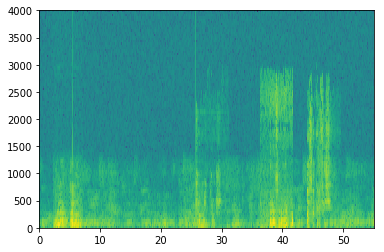

In [10]:
X_data = []
Y_data = []
num_data = 2000

# cnt_data = 0
# while True:
for cnt_data in range(1, num_data + 1):
    print('Creating {0} of {1}. Progress: {2}'.format(cnt_data, num_data, cnt_data/float(num_data)))
    x, y = create_training_example(cnt_data, backgrounds, activates, negatives)
    X_data.append(x.transpose())
    Y_data.append(y.transpose())
    
    if cnt_data == num_data:
        np.save('./XY_thalon_train_stereo/X_thalon.npy', X_data)
        np.save('./XY_thalon_train_stereo/Y_thalon.npy', Y_data)
        print('************************* Saving data at {} iteration **********************'.format(cnt_data))
    '''
    if cnt_data % 1000 == 0:
        x = input('Enter your input (x to exit):')
        if x == 'x':
            break
    
    cnt_data += 1
    '''

In [3]:
X = np.load('./XY_thalon_train/X_thalon.npy')
Y = np.load('./XY_thalon_train/Y_thalon.npy')

print(type(X), X.shape)
print(type(Y), Y.shape)

# <class 'numpy.ndarray'> (3501, 5511, 101)
# <class 'numpy.ndarray'> (3501, 1375, 1)

<class 'numpy.ndarray'> (4000, 5511, 101)
<class 'numpy.ndarray'> (4000, 1375, 1)


In [5]:
IPython.display.Audio('./raw_thalon_audios_stereo/train_1154.wav')

Finally, you can plot the associated labels for the generated training example.

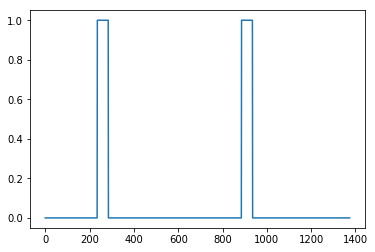

In [6]:
plt.plot(Y[0])

# 2 - Model

Now that you've built a dataset, lets write and train a trigger word detection model! 

The model will use 1-D convolutional layers, GRU layers, and dense layers. Let's load the packages that will allow you to use these layers in Keras. This might take a minute to load. 

In [4]:
from keras.callbacks import ModelCheckpoint
from keras.models import Model, load_model, Sequential
from keras.layers import Dense, Activation, Dropout, Input, Masking, TimeDistributed, LSTM, Conv1D
from keras.layers import GRU, Bidirectional, BatchNormalization, Reshape
from keras.optimizers import Adam

Using TensorFlow backend.


In [5]:
callbacks_list = [ModelCheckpoint(
    filepath='./exported_models/V1_2_full/hola_thalon-{epoch:02d}-{acc:.2f}.h5',
    monitor='acc')
]

## 2.1 - Build the model

Here is the architecture we will use. Take some time to look over the model and see if it makes sense. 

<img src="images/model_trigger.png" style="width:600px;height:600px;">
<center> **Figure 3** </center>

One key step of this model is the 1D convolutional step (near the bottom of Figure 3). It inputs the 5511 step spectrogram, and outputs a 1375 step output, which is then further processed by multiple layers to get the final $T_y = 1375$ step output. This layer plays a role similar to the 2D convolutions you saw in Course 4, of extracting low-level features and then possibly generating an output of a smaller dimension. 

Computationally, the 1-D conv layer also helps speed up the model because now the GRU  has to process only 1375 timesteps rather than 5511 timesteps. The two GRU layers read the sequence of inputs from left to right, then ultimately uses a dense+sigmoid layer to make a prediction for $y^{\langle t \rangle}$. Because $y$ is binary valued (0 or 1), we use a sigmoid output at the last layer to estimate the chance of the output being 1, corresponding to the user having just said "activate."

Note that we use a uni-directional RNN rather than a bi-directional RNN. This is really important for trigger word detection, since we want to be able to detect the trigger word almost immediately after it is said. If we used a bi-directional RNN, we would have to wait for the whole 10sec of audio to be recorded before we could tell if "activate" was said in the first second of the audio clip.  


Implementing the model can be done in four steps:
    
**Step 1**: CONV layer. Use `Conv1D()` to implement this, with 196 filters, 
a filter size of 15 (`kernel_size=15`), and stride of 4. [[See documentation.](https://keras.io/layers/convolutional/#conv1d)]

**Step 2**: First GRU layer. To generate the GRU layer, use:
```
X = GRU(units = 128, return_sequences = True)(X)
```
Setting `return_sequences=True` ensures that all the GRU's hidden states are fed to the next layer. Remember to follow this with Dropout and BatchNorm layers. 

**Step 3**: Second GRU layer. This is similar to the previous GRU layer (remember to use `return_sequences=True`), but has an extra dropout layer. 

**Step 4**: Create a time-distributed dense layer as follows: 
```
X = TimeDistributed(Dense(1, activation = "sigmoid"))(X)
```
This creates a dense layer followed by a sigmoid, so that the parameters used for the dense layer are the same for every time step. [[See documentation](https://keras.io/layers/wrappers/).]

**Exercise**: Implement `model()`, the architecture is presented in Figure 3.

In [6]:
# GRADED FUNCTION: model

def model(input_shape):
    """
    Function creating the model's graph in Keras.
    
    Argument:
    input_shape -- shape of the model's input data (using Keras conventions)

    Returns:
    model -- Keras model instance
    """
    
    X_input = Input(shape = input_shape)
    
    ### START CODE HERE ###
    
    # Step 1: CONV layer (≈4 lines)
    X = Conv1D(196, kernel_size=15, strides=4)(X_input)                                 # CONV1D
    X = BatchNormalization()(X)                                 # Batch normalization
    X = Activation('relu')(X)                                 # ReLu activation
    X = Dropout(0.2)(X)                                 # dropout (use 0.8)

    # Step 2: First GRU Layer (≈4 lines)
    X = GRU(units = 128, return_sequences = True)(X) # GRU (use 128 units and return the sequences)
    X = Dropout(0.2)(X)                                 # dropout (use 0.8)
    X = BatchNormalization()(X)                                 # Batch normalization
    
    # Step 3: Second GRU Layer (≈4 lines)
    X = GRU(units = 128, return_sequences = True)(X)   # GRU (use 128 units and return the sequences)
    X = Dropout(0.2)(X)                                 # dropout (use 0.8)
    X = BatchNormalization()(X)                                  # Batch normalization
    X = Dropout(0.2)(X)                                  # dropout (use 0.8)
    
    # Step 4: Time-distributed dense layer (≈1 line)
    X = TimeDistributed(Dense(1, activation = "sigmoid"))(X) # time distributed  (sigmoid)

    ### END CODE HERE ###

    model = Model(inputs = X_input, outputs = X)
    
    return model  

In [7]:
model = model(input_shape = (Tx, n_freq))

Let's print the model summary to keep track of the shapes.

In [8]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 5511, 101)         0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 1375, 196)         297136    
_________________________________________________________________
batch_normalization_1 (Batch (None, 1375, 196)         784       
_________________________________________________________________
activation_1 (Activation)    (None, 1375, 196)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 1375, 196)         0         
_________________________________________________________________
gru_1 (GRU)                  (None, 1375, 128)         124800    
_________________________________________________________________
dropout_2 (Dropout)          (None, 1375, 128)         0         
__________

**Expected Output**:

<table>
    <tr>
        <td>
            **Total params**
        </td>
        <td>
           522,561
        </td>
    </tr>
    <tr>
        <td>
            **Trainable params**
        </td>
        <td>
           521,657
        </td>
    </tr>
    <tr>
        <td>
            **Non-trainable params**
        </td>
        <td>
           904
        </td>
    </tr>
</table>

The output of the network is of shape (None, 1375, 1) while the input is (None, 5511, 101). The Conv1D has reduced the number of steps from 5511 at spectrogram to 1375. 

## 2.2 - Fit the model

Trigger word detection takes a long time to train. To save time, we've already trained a model for about 3 hours on a GPU using the architecture you built above, and a large training set of about 4000 examples. Let's load the model. 

In [9]:
model = load_model('./models/tr_model.h5')

/root/.virtualenvs/gpu-py3/lib/python3.5/site-packages/keras/engine/saving.py:327: UserWarning: Error in loading the saved optimizer state. As a result, your model is starting with a freshly initialized optimizer.
  warnings.warn('Error in loading the saved optimizer '


In [9]:
from keras import backend as K

def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

You can train the model further, using the Adam optimizer and binary cross entropy loss, as follows. This will run quickly because we are training just for one epoch and with a small training set of 26 examples. 

In [10]:
opt = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, decay=0.01)
model.compile(loss='binary_crossentropy', optimizer=opt, metrics=["accuracy"])

# model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics=["accuracy"])
# model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics=['acc', f1_m, precision_m, recall_m])

In [11]:
# model.fit(X, Y, batch_size = 5, epochs=1)
model.fit(X, Y, batch_size = 16, epochs = 20, callbacks=callbacks_list)
# model.fit(X, Y, batch_size = 16, epochs = 10, validation_split = 0.3)

Epoch 1/20
4000/4000 [==============================] - 736s 184ms/step - loss: 0.2119 - acc: 0.9287
Epoch 2/20
4000/4000 [==============================] - 1128s 282ms/step - loss: 0.1622 - acc: 0.9378
Epoch 3/20
4000/4000 [==============================] - 1148s 287ms/step - loss: 0.1466 - acc: 0.9431
Epoch 4/20
4000/4000 [==============================] - 1129s 282ms/step - loss: 0.1407 - acc: 0.9457
Epoch 5/20
4000/4000 [==============================] - 1084s 271ms/step - loss: 0.1334 - acc: 0.9481
Epoch 6/20
4000/4000 [==============================] - 1088s 272ms/step - loss: 0.1304 - acc: 0.9497
Epoch 7/20
4000/4000 [==============================] - 1101s 275ms/step - loss: 0.1285 - acc: 0.9506
Epoch 8/20
4000/4000 [==============================] - 1099s 275ms/step - loss: 0.1252 - acc: 0.9518
Epoch 9/20
4000/4000 [==============================] - 1097s 274ms/step - loss: 0.1236 - acc: 0.9530
Epoch 10/20
4000/4000 [==============================] - 1096s 274ms/step - loss: 0

# 3 - Making Predictions

Now that you have built a working model for trigger word detection, let's use it to make predictions. This code snippet runs audio (saved in a wav file) through the network. 

<!--
can use your model to make predictions on new audio clips.

You will first need to compute the predictions for an input audio clip.

**Exercise**: Implement predict_activates(). You will need to do the following:

1. Compute the spectrogram for the audio file
2. Use `np.swap` and `np.expand_dims` to reshape your input to size (1, Tx, n_freqs)
5. Use forward propagation on your model to compute the prediction at each output step
!-->

In [14]:
def detect_triggerword(filename):
    plt.subplot(2, 1, 1)

    x = graph_spectrogram(filename)
    # the spectogram outputs (freqs, Tx) and we want (Tx, freqs) to input into the model
    x  = x.swapaxes(0,1)
    x = np.expand_dims(x, axis=0)
    predictions = model.predict(x)
    
    plt.subplot(2, 1, 2)
    plt.plot(predictions[0,:,0])
    plt.ylabel('probability')
    plt.show()
    return predictions

Once you've estimated the probability of having detected the word "activate" at each output step, you can trigger a "chiming" sound to play when the probability is above a certain threshold. Further, $y^{\langle t \rangle}$ might be near 1 for many values in a row after "activate" is said, yet we want to chime only once. So we will insert a chime sound at most once every 75 output steps. This will help prevent us from inserting two chimes for a single instance of "activate". (This plays a role similar to non-max suppression from computer vision.) 

<!-- 
**Exercise**: Implement chime_on_activate(). You will need to do the following:

1. Loop over the predicted probabilities at each output step
2. When the prediction is larger than the threshold and more than 75 consecutive time steps have passed, insert a "chime" sound onto the original audio clip

Use this code to convert from the 1,375 step discretization to the 10,000 step discretization and insert a "chime" using pydub:

` audio_clip = audio_clip.overlay(chime, position = ((i / Ty) * audio.duration_seconds)*1000)
`
!--> 

In [16]:
chime_file = "audio_examples/chime.wav"
def chime_on_activate(filename, predictions, threshold):
    audio_clip = AudioSegment.from_wav(filename)
    chime = AudioSegment.from_wav(chime_file)
    Ty = predictions.shape[1]
    # Step 1: Initialize the number of consecutive output steps to 0
    consecutive_timesteps = 0
    # Step 2: Loop over the output steps in the y
    for i in range(Ty):
        # Step 3: Increment consecutive output steps
        consecutive_timesteps += 1
        # Step 4: If prediction is higher than the threshold and more than 75 consecutive output steps have passed
        if predictions[0,i,0] > threshold and consecutive_timesteps > 75:
            # Step 5: Superpose audio and background using pydub
            audio_clip = audio_clip.overlay(chime, position = ((i / Ty) * audio_clip.duration_seconds)*1000)
            # Step 6: Reset consecutive output steps to 0
            consecutive_timesteps = 0
        
    audio_clip.export("chime_output.wav", format='wav')

## 3.3 - Test on dev examples

Let's explore how our model performs on two unseen audio clips from the development set. Lets first listen to the two dev set clips. 

In [16]:
IPython.display.Audio("./raw_thalon_audios/train_2.wav")

In [17]:
IPython.display.Audio("./raw_thalon_audios/train_9.wav")

Now lets run the model on these audio clips and see if it adds a chime after "activate"!

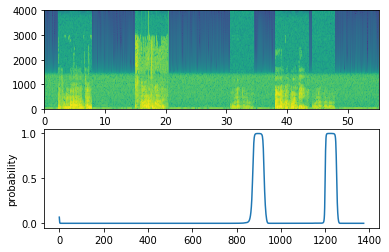

In [18]:
filename = "./raw_thalon_audios/train_1.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

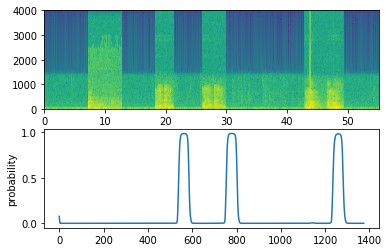

In [36]:
filename  = "./raw_thalon_audios/train_10.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

In [32]:
# model.save('hola_thalon_trigger.h5')

In [12]:
def detect_triggerword2(filename):
    plt.subplot(2, 1, 1)

    x = graph_spectrogram(filename)
    # the spectogram outputs (freqs, Tx) and we want (Tx, freqs) to input into the model
    x  = x.swapaxes(0,1)
    x = np.expand_dims(x, axis=0)
    predictions = model2.predict(x)
    
    plt.subplot(2, 1, 2)
    plt.plot(predictions[0,:,0])
    plt.ylabel('probability')
    plt.show()
    return predictions

In [13]:
from keras.models import load_model
## Seems to work
# model2 = load_model('./exported_models/V1_full/hola_thalon-04-0.98.h5')
#### requires to add extra background
#############
model2 = load_model('./exported_models/V1_2_full/hola_thalon-14-0.96.h5')
# model2.summary()

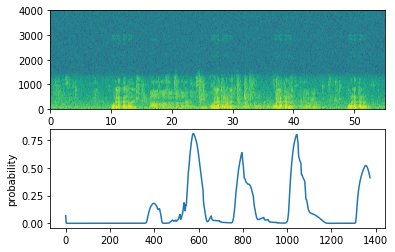

In [21]:
filename  = "./audio_examples/thalon/output_3_10sec_mod.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

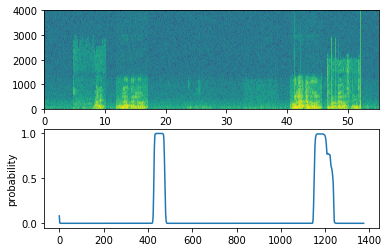

In [25]:
filename  = "./raw_thalon_audios_stereo/train_1227.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

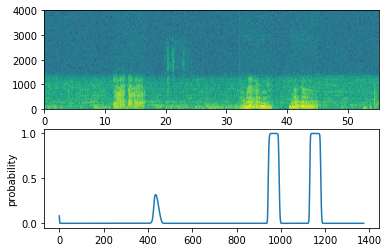

In [26]:
filename  = "./raw_thalon_audios_stereo/train_527.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.2)
IPython.display.Audio("./chime_output.wav")

In [6]:
activates_test, negatives, backgrounds = load_raw_audio_thalon_list_test()
print(len(activates_test), len(negatives), len(backgrounds))

4 7058 8642


In [13]:
def create_testing_example(counter, backgrounds, activates, negatives):
    """
    Creates a training example with a given background, activates, and negatives.
    
    Arguments:
    background -- a 10 second background audio recording
    activates -- a list of audio segments of the word "activate"
    negatives -- a list of audio segments of random words that are not "activate"
    
    Returns:
    x -- the spectrogram of the training example
    y -- the label at each time step of the spectrogram
    """
    
    # Select 0-4 random "activate" audio clips from the entire list of "activates" recordings
    random_activates = load_raw_data(random.sample(activates, k=random.randint(1, 3)))
    print('random_activates', len(random_activates))
    
    # Select 0-2 random negatives audio recordings from the entire list of "negatives" recordings
    random_negatives = [] # load_raw_data(random.sample(negatives, k=random.randint(1, 3)))
    print('random_negatives', len(random_negatives))
    
    background = load_raw_data(random.sample(backgrounds, k=1))
    print('background', len(background))
    
    # Make background quieter
    background = background[0] - 20

    ### START CODE HERE ###
    # Step 1: Initialize y (label vector) of zeros (≈ 1 line)
    y = np.zeros((1, Ty))

    # Step 2: Initialize segment times as empty list (≈ 1 line)
    previous_segments = []
    ### END CODE HERE ###
    
    
    ### START CODE HERE ### (≈ 3 lines)
    # Step 3: Loop over randomly selected "activate" clips and insert in background
    for random_activate in random_activates:
        # Insert the audio clip on the background
        background, segment_time = insert_audio_clip(background, random_activate, previous_segments)
        # Retrieve segment_start and segment_end from segment_time
        segment_start, segment_end = segment_time
        # Insert labels in "y"
        y = insert_ones(y, segment_end_ms=segment_end)
    ### END CODE HERE ###
    
    print('previous_segments_active:', previous_segments)    

    ### START CODE HERE ### (≈ 2 lines)
    # Step 4: Loop over randomly selected negative clips and insert in background
    for random_negative in random_negatives:
        # Insert the audio clip on the background 
        background, _ = insert_audio_clip(background, random_negative, previous_segments)
    ### END CODE HERE ###
    
    # Standardize the volume of the audio clip 
    background = match_target_amplitude(background, -20.0)
    
    print('previous_segments_total:', previous_segments)

    # Export new training example 
    file_handle = background.export("./raw_thalon_audios_test/test_" + str(counter) + ".wav", format="wav")
    print("File (test_" + str(counter) + ".wav) was saved in your directory.")
    
    # Get and plot spectrogram of the new recording (background with superposition of positive and negatives)
    x = graph_spectrogram("./raw_thalon_audios_test/test_" + str(counter) + ".wav")
    
    return x, y

opening ./audio_test/microphone_results_test.wav
opening ./audio_test/microphone_results_test (copy).wav
random_activates 2
random_negatives 0
opening ./database/wav_resampling/backgrounds_10sec/ch06_5_23.wav
background 1
previous_segments_active: [(76, 843), (8598, 9365)]
previous_segments_total: [(76, 843), (8598, 9365)]
File (test_1.wav) was saved in your directory.
opening ./audio_test/microphone_results_test (copy).wav
random_activates 1
random_negatives 0
opening ./database/wav_resampling/backgrounds_10sec/ch14_13_21.wav
background 1
previous_segments_active: [(4111, 4878)]
previous_segments_total: [(4111, 4878)]
File (test_2.wav) was saved in your directory.
opening ./audio_test/microphone_results_test (3rd copy).wav
opening ./audio_test/microphone_results_test.wav
random_activates 2
random_negatives 0
opening ./database/wav_resampling/backgrounds_10sec/ch16_25.wav
background 1
previous_segments_active: [(2789, 3556), (3975, 4742)]
previous_segments_total: [(2789, 3556), (3975, 

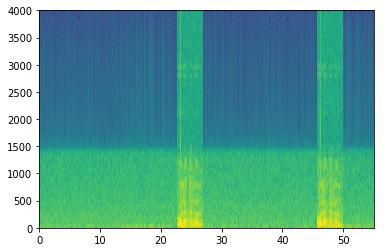

In [25]:
X_data = []
Y_data = []
num_data = 10

# cnt_data = 0
# while True:
for cnt_data in range(1, num_data + 1):
    x, y = create_testing_example(cnt_data, backgrounds, activates_test, negatives)
    X_data.append(x.transpose())
    Y_data.append(y.transpose())
    
    if cnt_data == num_data:
        np.save('./XY_thalon_test/X_thalon.npy', X_data)
        np.save('./XY_thalon_test/Y_thalon.npy', Y_data)
        print('************************* Saving data at {} iteration **********************'.format(cnt_data))
    '''
    if cnt_data % 1000 == 0:
        x = input('Enter your input (x to exit):')
        if x == 'x':
            break
    
    cnt_data += 1
    '''

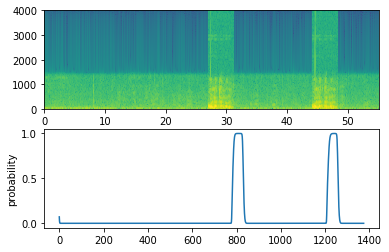

In [35]:
filename  = "./raw_thalon_audios_test/test_5.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.1)
IPython.display.Audio("./chime_output.wav")

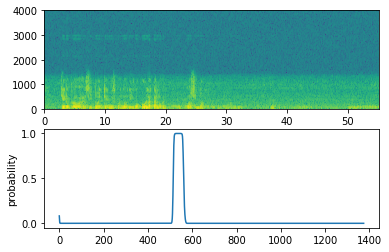

In [28]:
filename  = "./audio_examples/thalon/test_audio_1_mod.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.8)
IPython.display.Audio("./chime_output.wav")

In [47]:
filename = "./audio_examples/thalon/output_2_10sec.wav"
audio_clip = AudioSegment.from_wav(filename)
audio_clip.export('./audio_examples/thalon/output_2_10sec_amp.wav', format="wav")

<_io.BufferedRandom name='./audio_examples/thalon/output_2_10sec_amp.wav'>

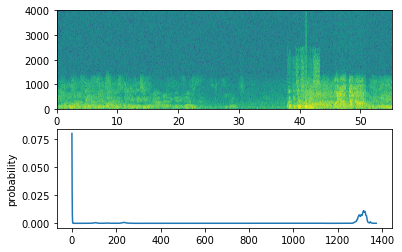

In [59]:
filename2 = "./audio_examples/thalon/output_2_10sec.wav"
filename2 = "./raw_thalon_audios_stereo/train_997.wav"
prediction = detect_triggerword2(filename2)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")